<a href="https://colab.research.google.com/github/JoseMa39/reports/blob/master/adgClusteringNaiveFromCardex.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Carga y limpieza de los datos

## Configuracion inicial

In [1]:
import pandas as pd
import numpy as np
from plotnine import *
from google.colab import data_table

import seaborn as sns
import matplotlib.pyplot as plt
from plotnine.data import mtcars

pd.options.display.float_format = '{:.2f}'.format

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
dfCardex = pd.read_csv("./drive/MyDrive/adgTravel/upselling/cardex.csv")
dfCardex.head(5)

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (30) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,Clave,TipoDocumento,Documento,Nombre,Apellido1,Apellido2,Sexo,FechaNacimiento,Nacionalidad,CodigoPostal,PaisResidencia,EMail,Reserva,Linea,Numero,Localizador,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Tarifa,Venta,Canal,Segmento,Facturado
0,DDE22156-97C3-4868-984F-434382D5EEC5,PASAPORTE,535454658,VICKY ELIZABETH,ATKINSON,NaN,F,3/7/1960,GBR,56454B,GBR,vicky143@hotmail.co.uk,TGHRE170005263,1,1,3398711,H06,Salida,1/12/2017,1/19/2017,DBL,HB,1,0,1,0,TUI UK LTD.,H06,DBLC,HB,NaN,1/8/2017,TTOO,NaN,-86.10
1,B62ECF0A-ECD8-4B41-94B0-A50CE788CCF3,DNI,28812400R,BRU RUANO,VICENTE,NaN,M,10/6/1981,ESP,NaN,NaN,NaN,TGHRE170007445,1,1,113369188,H06,Salida,4/14/2017,4/16/2017,IND,HB,2,0,0,0,JUMBO CANARIAS,H06,DBL,HB,NaN,4/14/2017,ONLINE,NaN,-152.00
2,B0FACB63-689D-43C0-A765-1F8935F5E681,DNI,43802318Z,BEATRIZ ALONSO,RODRIGUEZ,NaN,F,8/1/1975,ESP,NaN,NaN,NaN,TGHRE170007445,1,2,113369188,H06,Salida,4/14/2017,4/16/2017,IND,HB,2,0,0,0,JUMBO CANARIAS,H06,DBL,HB,NaN,4/14/2017,ONLINE,NaN,-152.00
3,104B47D6-2F5C-4F47-AC1D-B3D9F00FB9A6,DNI,03908922A,SERGIO,GUTIERREZ,DE LA FLOR,M,2/10/1984,ESP,19140,ESP,NaN,TGHRE170006338,1,1,139797058,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,NaN,3/6/2017,TTOO,NaN,22.80
4,019F3D73-B265-4353-939E-8598EFB54C8E,DNI,47077585N,NURIA,PANADERO,NaN,F,4/28/1984,ESP,NaN,NaN,NaN,TGHRE170006338,1,2,139797058,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,NaN,3/6/2017,TTOO,NaN,22.80


In [4]:
dfCardex.isnull().sum()

Clave                   0
TipoDocumento        5800
Documento            6069
Nombre                611
Apellido1            1558
Apellido2          334809
Sexo                    0
FechaNacimiento      6966
Nacionalidad         2510
CodigoPostal       193938
PaisResidencia      48370
EMail              237806
Reserva                 0
Linea                   0
Numero                  0
Localizador         12925
HotelUso                0
Estado                  0
Entrada                 0
Salida                  0
THUso                   0
RegimenUso              0
AD                      0
JR                      0
NI                      0
CU                      0
EntidadNegocio          0
HotelFactura            0
THFactura               0
RegimenFactura          0
Tarifa             377269
Venta                   7
Canal                 128
Segmento            71596
Facturado            5333
dtype: int64

In [5]:
dfCardex["Facturado"].sum()

358304561.3800002

In [6]:
dfByClients = dfCardex.groupby(['Documento']).count()
dfByClients[dfByClients["Clave"]> 2]

,Clave,TipoDocumento,Nombre,Apellido1,Apellido2,Sexo,FechaNacimiento,Nacionalidad,CodigoPostal,PaisResidencia,EMail,Reserva,Linea,Numero,Localizador,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Tarifa,Venta,Canal,Segmento,Facturado
Documento,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,34,34,34,34,2,34,34,34,21,27,8,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,0,34,34,33,34
00194693K,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,0,3,3,2,3
00403877C,3,3,3,3,3,3,3,3,2,3,2,3,3,3,0,3,3,3,3,3,3,3,3,3,3,3,3,3,3,0,3,3,3,3
00823293P,3,3,3,3,3,3,3,3,3,3,2,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,0,3,3,3,3
01115441X,3,3,3,3,3,3,3,3,2,3,2,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,0,3,3,3,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
YB7051689,3,3,3,3,0,3,3,3,0,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,0,3
YC012331,3,3,3,3,2,3,3,3,3,3,2,3,3,3,2,3,3,3,3,3,3,3,3,3,3,3,3,3,3,1,3,3,0,3
YC244695,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,6,0,6,6,2,6


In [7]:
dfCardex.columns

Index(['Clave', 'TipoDocumento', 'Documento', 'Nombre', 'Apellido1',
       'Apellido2', 'Sexo', 'FechaNacimiento', 'Nacionalidad', 'CodigoPostal',
       'PaisResidencia', 'EMail', 'Reserva', 'Linea', 'Numero', 'Localizador',
       'HotelUso', 'Estado', 'Entrada', 'Salida', 'THUso', 'RegimenUso', 'AD',
       'JR', 'NI', 'CU', 'EntidadNegocio', 'HotelFactura', 'THFactura',
       'RegimenFactura', 'Tarifa', 'Venta', 'Canal', 'Segmento', 'Facturado'],
      dtype='object')

## Clasificando datos

In [8]:
dfCardexClassified = dfCardex.drop(['Clave', 'TipoDocumento', 'Nombre', "Apellido1", "Apellido2"], axis = 1)

## Sexo (categorica)

In [9]:
dfCardexClassified["Sexo"] = pd.Categorical(dfCardexClassified["Sexo"])
dfCardexClassified.head(10)

,Documento,Sexo,FechaNacimiento,Nacionalidad,CodigoPostal,PaisResidencia,EMail,Reserva,Linea,Numero,Localizador,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Tarifa,Venta,Canal,Segmento,Facturado
0,535454658,F,3/7/1960,GBR,56454B,GBR,vicky143@hotmail.co.uk,TGHRE170005263,1,1,3398711,H06,Salida,1/12/2017,1/19/2017,DBL,HB,1,0,1,0,TUI UK LTD.,H06,DBLC,HB,NaN,1/8/2017,TTOO,NaN,-86.10
1,28812400R,M,10/6/1981,ESP,NaN,NaN,NaN,TGHRE170007445,1,1,113369188,H06,Salida,4/14/2017,4/16/2017,IND,HB,2,0,0,0,JUMBO CANARIAS,H06,DBL,HB,NaN,4/14/2017,ONLINE,NaN,-152.00
2,43802318Z,F,8/1/1975,ESP,NaN,NaN,NaN,TGHRE170007445,1,2,113369188,H06,Salida,4/14/2017,4/16/2017,IND,HB,2,0,0,0,JUMBO CANARIAS,H06,DBL,HB,NaN,4/14/2017,ONLINE,NaN,-152.00
3,03908922A,M,2/10/1984,ESP,19140,ESP,NaN,TGHRE170006338,1,1,139797058,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,NaN,3/6/2017,TTOO,NaN,22.80
4,47077585N,F,4/28/1984,ESP,NaN,NaN,NaN,TGHRE170006338,1,2,139797058,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,NaN,3/6/2017,TTOO,NaN,22.80
5,31246412S,M,8/14/1966,ESP,NaN,NaN,NaN,LZRE170030391,1,1,NaN,H04,Salida,5/3/2017,5/4/2017,DBVM,HB,1,0,0,0,CUENTA CASA,H04,DUI,HB,NaN,5/3/2017,COMPLEMENTARY,NaN,-0.01
6,11426872N,F,3/29/1971,ESP,33401,ESP,NaN,TGHRE170006099,1,1,139616716,H06,Salida,5/4/2017,5/11/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBLC,HB,NaN,2/21/2017,TTOO,NaN,-24.36
7,76964457V,M,8/6/1986,ESP,33401,ESP,NaN,TGHRE170006099,1,2,139616716,H06,Salida,5/4/2017,5/11/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBLC,HB,NaN,2/21/2017,TTOO,NaN,-24.36
8,14932477,F,5/8/1995,PRT,NaN,NaN,NaN,TGHRE170007333,1,1,143033216,H06,Salida,5/11/2017,5/18/2017,DBL,HB,2,0,0,0,V.SOLTOUR SA,H06,DBLC,HB,NaN,4/8/2017,TTOO,NaN,0.00
9,13089737,M,3/24/1988,PRT,8300-235,PRT,NaN,TGHRE170007333,1,2,143033216,H06,Salida,5/11/2017,5/18/2017,DBL,HB,2,0,0,0,V.SOLTOUR SA,H06,DBLC,HB,NaN,4/8/2017,TTOO,NaN,0.00


## Nacionalidad

In [10]:
dfCardexClassified["PaisResidencia"].unique()

array(['GBR', nan, 'ESP', 'PRT', 'NLD', 'DEU', 'AUT', 'CHE', 'CHN', 'CZE',
       'JPN', 'FRA', 'HUN', 'POL', 'BEL', 'FIN', 'SWE', 'ITA', 'DNK',
       'HRV', 'AUS', 'RUS', 'BIH', 'ARE', 'ROU', 'LVA', 'PER', 'MEX',
       'MAR', 'USA', 'SGP', 'IRL', 'CAN', 'BGR', 'EST', 'LTU', 'NOR',
       'IMN', 'ECU', 'SWZ', 'MKD', 'SVK', 'GRC', 'BRA', 'ISR', 'SVN',
       'MLT', 'AND', 'TUR', 'ARG', 'AFG', 'LUX', 'IND', 'KOR', 'SYR',
       'SEN', 'MYS', 'NZL', 'DOM', 'PHL', 'ZAF', 'ISL', 'JAM', 'LIE',
       'MUS', 'KAZ', 'DZA', 'URY', 'TUN', 'GAB', 'VEN', 'UKR', 'TWN',
       'SCG', 'COL', 'CYP', 'IRN', 'TTO', 'VNM', 'ALB', 'REU', 'BLR',
       'THA', 'ZWE', 'CHL', 'UGA', 'MDA', 'KGZ', 'QAT', 'ARM', 'LBN',
       'NAM', 'SRB', 'GEO', 'CUB', 'SAU', 'VCT', 'MNG', 'IRQ', 'JOR',
       'AZE', 'CRI', 'ABW', 'BOL', 'EGY', 'COK', 'GTM', 'GHA', 'BTN',
       'CMR', 'NGA', 'AGO', 'COD', 'KEN', 'ASM', 'MDG', 'KWT', 'PAK',
       'PAN', 'IDN', 'KNA', 'OMN', 'TZA', 'MNE', 'LKA', 'PSE', 'ERI',
       'HTI', '

In [11]:
dfCardexClassified["PaisResidencia"] = dfCardexClassified["PaisResidencia"].fillna(dfCardexClassified["Nacionalidad"])


In [12]:
dfCardexClassified.loc[dfCardexClassified['PaisResidencia']=="VARIOS","PaisResidencia"] = dfCardexClassified["Nacionalidad"]

In [13]:
dfCardexClassified.loc[dfCardexClassified['PaisResidencia'] == 'SCG','PaisResidencia'] = 'SRB'

In [14]:
dfCardexClassified["PaisResidencia"] = pd.Categorical(dfCardexClassified["PaisResidencia"])

dfCardexClassified.describe(include="category")


,Sexo,PaisResidencia
count,389354,388313
unique,2,169
top,M,GBR
freq,219050,162510


In [15]:
dfCardexClassified = dfCardexClassified.dropna(subset=["PaisResidencia", "Facturado"])
dfCardexClassified.isnull().sum()

Documento            2093
Sexo                    0
FechaNacimiento      2987
Nacionalidad          763
CodigoPostal       188793
PaisResidencia          0
EMail              235579
Reserva                 0
Linea                   0
Numero                  0
Localizador         11639
HotelUso                0
Estado                  0
Entrada                 0
Salida                  0
THUso                   0
RegimenUso              0
AD                      0
JR                      0
NI                      0
CU                      0
EntidadNegocio          0
HotelFactura            0
THFactura               0
RegimenFactura          0
Tarifa             373931
Venta                   7
Canal                  99
Segmento            66917
Facturado               0
dtype: int64

In [16]:
dfCardexClassified = dfCardexClassified.drop(['Nacionalidad', 'CodigoPostal', 'Localizador', "Tarifa"], axis = 1)


### EMail

In [17]:
dfCardexClassified["Has_Email"] = dfCardexClassified["EMail"].notnull()

In [18]:
dfCardexClassified

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email
0,535454658,F,3/7/1960,GBR,vicky143@hotmail.co.uk,TGHRE170005263,1,1,H06,Salida,1/12/2017,1/19/2017,DBL,HB,1,0,1,0,TUI UK LTD.,H06,DBLC,HB,1/8/2017,TTOO,NaN,-86.10,True
1,28812400R,M,10/6/1981,ESP,NaN,TGHRE170007445,1,1,H06,Salida,4/14/2017,4/16/2017,IND,HB,2,0,0,0,JUMBO CANARIAS,H06,DBL,HB,4/14/2017,ONLINE,NaN,-152.00,False
2,43802318Z,F,8/1/1975,ESP,NaN,TGHRE170007445,1,2,H06,Salida,4/14/2017,4/16/2017,IND,HB,2,0,0,0,JUMBO CANARIAS,H06,DBL,HB,4/14/2017,ONLINE,NaN,-152.00,False
3,03908922A,M,2/10/1984,ESP,NaN,TGHRE170006338,1,1,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,NaN,22.80,False
4,47077585N,F,4/28/1984,ESP,NaN,TGHRE170006338,1,2,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,NaN,22.80,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
386040,JCL3X9E5,M,11/27/1990,LUX,NaN,H20RE210010325,1,2,H20,En Hotel,3/17/2021,3/24/2021,JSVMPC,HB,2,0,0,0,DIRECTO WEB AMIGO,H20,JSVMPC,HB,3/17/2021,DIRECT,NaN,2052.97,False
386041,C4YMXL71G,F,1/24/1991,GBR,dianakyllmann@gmail.com,H20RE210010317,1,2,H20,En Hotel,3/17/2021,3/18/2021,DBVMPC,BB,2,0,0,0,DIRECTO,H20,DBVMPC,BB,3/17/2021,DIRECT,NaN,215.66,True
386042,19E177251,M,6/29/1963,FRA,adsuarfamily@hotmail.fr,H20RE210010002,2,1,H20,En Hotel,3/17/2021,3/22/2021,DBVM,BB,2,0,0,0,BOOKING.COM B.V.,H20,DBVM,BB,3/10/2021,OTAS,NaN,1191.00,True
386046,18AA04209,F,7/30/1966,FRA,NaN,H20RE210010002,2,2,H20,En Hotel,3/17/2021,3/22/2021,DBVM,BB,2,0,0,0,BOOKING.COM B.V.,H20,DBVM,BB,3/10/2021,OTAS,NaN,1191.00,False


In [19]:
# dfCardexClassified = dfCardexClassified.dropna(subset=["PaisResidencia", "Facturado"])
dfCardexClassified.isnull().sum()

Documento            2093
Sexo                    0
FechaNacimiento      2987
PaisResidencia          0
EMail              235579
Reserva                 0
Linea                   0
Numero                  0
HotelUso                0
Estado                  0
Entrada                 0
Salida                  0
THUso                   0
RegimenUso              0
AD                      0
JR                      0
NI                      0
CU                      0
EntidadNegocio          0
HotelFactura            0
THFactura               0
RegimenFactura          0
Venta                   7
Canal                  99
Segmento            66917
Facturado               0
Has_Email               0
dtype: int64

### Recodificando pais de residencia por regiones

In [20]:
countryCodesDf = pd.read_csv("./drive/MyDrive/adgTravel/upselling/countriesByRegion.csv", usecols=['alpha-3', 'sub-region', 'intermediate-region'], index_col=['alpha-3'])
countryCodesDf.head(3)

,sub-region,intermediate-region
alpha-3,,
AFG,Southern Asia,NaN
ALA,Northern Europe,NaN
ALB,Southern Europe,NaN


In [21]:
countryCodesIsNullDf = countryCodesDf.isnull()
dfGroupByCountry = dfCardexClassified['PaisResidencia'].value_counts()

In [22]:
def fillCountryWithRegion(row):
  if(dfGroupByCountry[row]>200 or row == "VARIOS"):
    return row
  if(not countryCodesIsNullDf.loc[row]['intermediate-region']):
    return countryCodesDf.loc[row]['intermediate-region']
  return countryCodesDf.loc[row]['sub-region']


dfCardexClassified["PaisResidencia"] = dfCardexClassified["PaisResidencia"].apply(fillCountryWithRegion)

In [23]:
dfCardexClassified['PaisResidencia'].value_counts().tail(15)

Southern Africa              207
South-eastern Asia           140
Northern Europe               83
Central America               73
VARIOS                        66
Eastern Africa                57
Caribbean                     57
Australia and New Zealand     52
Western Africa                50
Central Asia                  38
Eastern Europe                37
Middle Africa                 23
Western Europe                23
Polynesia                      7
Northern America               2
Name: PaisResidencia, dtype: int64

In [24]:
dfCardexClassified["PaisResidencia"].unique()

array(['GBR', 'ESP', 'PRT', 'CZE', 'NLD', 'DEU', 'FRA', 'AUT', 'POL',
       'CHE', 'Eastern Asia', 'RUS', 'HUN', 'ITA', 'SWE', 'FIN', 'DNK',
       'Southern Europe', 'Northern Europe', 'AUS', 'BEL', 'ARE', 'ROU',
       'LVA', 'South America', 'Central America', 'Northern Africa',
       'USA', 'South-eastern Asia', 'IRL', 'CAN', 'BGR', 'EST', 'LTU',
       'NOR', 'Southern Africa', 'SVK', 'BRA', 'Western Asia', 'ARG',
       'Caribbean', 'Middle Africa', 'Eastern Africa', 'Southern Asia',
       'LUX', 'Western Africa', 'Australia and New Zealand',
       'Western Europe', 'Central Asia', 'UKR', 'GAB', 'BLR',
       'Eastern Europe', 'Polynesia', 'Northern America', nan, 'VARIOS'],
      dtype=object)

## Corrigiendo Fechas de Nacimiento

In [25]:
def fixingBirthDates(date):
  if((not isinstance(date, str)) or date=="NaN" or date=="nan"):
    return date
  dateSplitted = date.split("/")
  year = int(dateSplitted[2])
  if year < 1900:
    print(date)
    year += 100 * ((2000 - year)//100)
  return f"{dateSplitted[0]}/{dateSplitted[1]}/{year}"

dfCardexClassified["FechaNacimiento"] = dfCardexClassified["FechaNacimiento"].apply(fixingBirthDates)

23/08/1851
08/06/1881
15/09/1847
01/04/1886
20/08/1880
16/08/1782
04/08/1882
17/09/1888


## Edad

In [26]:
def calculateAge(row):
  birthYear = int(row['FechaNacimiento'].split('/')[2])
  bookYear = int(row['Venta'].split('/')[2])
  return bookYear - birthYear

def getAgeRange(row):
  if(row.isnull().any()):
    return "NaN"
  return calculateAge(row)
  # if 18 <= age <  24:
  #   return "18-24"
  # if 25 <= age < 34:
  #   return "25-34"
  # if 35 <= age < 44:
  #   return "35-44"
  # if 45 <= age < 54:
  #   return "45-54"
  # if 55 <= age < 64:
  #   return "55-64"
  # return "65-oo"

dfCardexClassified["Edad"] = dfCardexClassified[["FechaNacimiento", "Venta"]].apply(getAgeRange, axis=1)

In [27]:
dfCardexClassified.describe()

,Linea,Numero,AD,JR,NI,CU,Facturado
count,383338.00,383338.00,383338.00,383338.00,383338.00,383338.00,383338.00
mean,1.81,1.53,2.06,0.01,0.18,0.04,933.33
std,3.86,0.59,0.45,0.11,0.48,0.19,651.38
min,1.00,1.00,0.00,0.00,0.00,0.00,-3069.13
25%,1.00,1.00,2.00,0.00,0.00,0.00,517.44
50%,1.00,1.00,2.00,0.00,0.00,0.00,809.00
75%,1.00,2.00,2.00,0.00,0.00,0.00,1221.12
max,117.00,10.00,10.00,4.00,6.00,2.00,28672.93


In [28]:
dfCardexClassified.head(10)
dfCardexClassified.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 383338 entries, 0 to 389266
Data columns (total 28 columns):
 #   Column           Non-Null Count   Dtype   
---  ------           --------------   -----   
 0   Documento        381245 non-null  object  
 1   Sexo             383338 non-null  category
 2   FechaNacimiento  380351 non-null  object  
 3   PaisResidencia   383337 non-null  object  
 4   EMail            147759 non-null  object  
 5   Reserva          383338 non-null  object  
 6   Linea            383338 non-null  int64   
 7   Numero           383338 non-null  int64   
 8   HotelUso         383338 non-null  object  
 9   Estado           383338 non-null  object  
 10  Entrada          383338 non-null  object  
 11  Salida           383338 non-null  object  
 12  THUso            383338 non-null  object  
 13  RegimenUso       383338 non-null  object  
 14  AD               383338 non-null  int64   
 15  JR               383338 non-null  int64   
 16  NI               383

In [29]:
dfCardexClassified["Edad"] = pd.to_numeric(dfCardexClassified["Edad"], errors="coerce", downcast="signed")
dfCardexClassified.describe()

,Linea,Numero,AD,JR,NI,CU,Facturado,Edad
count,383338.00,383338.00,383338.00,383338.00,383338.00,383338.00,383338.00,380344.00
mean,1.81,1.53,2.06,0.01,0.18,0.04,933.33,44.08
std,3.86,0.59,0.45,0.11,0.48,0.19,651.38,32.78
min,1.00,1.00,0.00,0.00,0.00,0.00,-3069.13,-7787.00
25%,1.00,1.00,2.00,0.00,0.00,0.00,517.44,30.00
50%,1.00,1.00,2.00,0.00,0.00,0.00,809.00,44.00
75%,1.00,2.00,2.00,0.00,0.00,0.00,1221.12,58.00
max,117.00,10.00,10.00,4.00,6.00,2.00,28672.93,118.00


In [30]:
dfCardexClassified[dfCardexClassified["Reserva"]=="TNRE170011139"]

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email,Edad
32,11116069,M,5/8/1977,PRT,NaN,TNRE170011139,1,1,H05,Salida,9/1/2017,9/8/2017,DBM,AI,2,0,1,0,V.SOLTOUR SA,H05,DBL,AI,4/26/2017,TTOO,NaN,0.00,False,40.00
33,11297007,F,7/1/1978,PRT,NaN,TNRE170011139,1,2,H05,Salida,9/1/2017,9/8/2017,DBM,AI,2,0,1,0,V.SOLTOUR SA,H05,DBL,AI,4/26/2017,TTOO,NaN,0.00,False,39.00
34,15280149,M,5/20/2003,PRT,NaN,TNRE170011139,2,1,H05,Salida,9/1/2017,9/8/2017,DBL,AI,2,0,0,0,V.SOLTOUR SA,H05,DBL,AI,4/26/2017,TTOO,NaN,0.00,False,14.00
35,15280180,F,2/17/1999,PRT,NaN,TNRE170011139,2,2,H05,Salida,9/1/2017,9/8/2017,DBL,AI,2,0,0,0,V.SOLTOUR SA,H05,DBL,AI,4/26/2017,TTOO,NaN,0.00,False,18.00
36,097028568ZZ4,M,10/28/1967,PRT,Paulo_Patnico@iol.pt,TNRE170011139,3,1,H05,Salida,9/1/2017,9/8/2017,DBL,AI,2,0,0,0,V.SOLTOUR SA,H05,DBL,AI,4/26/2017,TTOO,NaN,-214.76,True,50.00
37,9965741,F,5/21/1972,PRT,NaN,TNRE170011139,3,2,H05,Salida,9/1/2017,9/8/2017,DBL,AI,2,0,0,0,V.SOLTOUR SA,H05,DBL,AI,4/26/2017,TTOO,NaN,-214.76,False,45.00


In [31]:
# eliminando outliers

# dfCardexCleaned = dfCardexClassified.drop(dfCardexClassified["Facturado"])

dfCardexClassified.loc[(dfCardexClassified["Facturado"]<100) & (dfCardexClassified["Facturado"]>0), :]

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email,Edad
3,03908922A,M,2/10/1984,ESP,NaN,TGHRE170006338,1,1,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,NaN,22.80,False,33.00
4,47077585N,F,4/28/1984,ESP,NaN,TGHRE170006338,1,2,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,NaN,22.80,False,33.00
105,265327238,F,6/7/1969,DEU,FRENNA@EIRE.DE,LZRE170033051,1,1,H04,Salida,11/25/2017,11/30/2017,DBL,BB,2,0,0,0,SIDETOURS/ALEMAN,H04,DBL,BB,9/26/2017,NaN,NaN,22.90,True,48.00
106,L3R10H581,F,9/25/1995,DEU,FRENNA@EIRE.DE,LZRE170033051,1,2,H04,Salida,11/25/2017,11/30/2017,DBL,BB,2,0,0,0,SIDETOURS/ALEMAN,H04,DBL,BB,9/26/2017,NaN,NaN,22.90,True,22.00
118,L716167ZL,F,10/25/1929,DEU,NaN,LZRE170034435,1,1,H04,Salida,11/29/2017,1/21/2018,DBVPM,HB,1,0,0,0,DIRECTO,H04,DUI,HB,11/20/2017,DIRECT,NaN,68.00,False,88.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
384912,09257949N,M,2/4/1960,ESP,santiago.milans@gmail.com,H20RE210008944,2,1,H20,Salida,2/3/2021,2/4/2021,DBL,BB,1,0,0,0,HI PARTNERS HOLDCO,H20,DBL,BB,2/2/2021,DIRECT,NaN,61.00,True,61.00
384944,AV7892319,F,7/28/1963,ESP,antonellacamponeschi@yahoo.it,H20RE210008692,18,1,H20,Salida,2/4/2021,2/5/2021,DBVP,BB,1,0,0,0,FAROLITO PRODUCTIONS,H20,DBVMPC,BB,1/21/2021,AGENCY,NaN,95.00,True,58.00
385033,78593749N,M,5/7/1993,ESP,alvaro.febo@gmail.com,H20RE210009003,1,1,H20,Salida,2/7/2021,2/8/2021,DBL,BB,1,0,0,0,DIRECTOS CC AMIGOS,H20,DBL,BB,2/5/2021,DIRECT,NaN,92.65,True,28.00
385256,78518304F,M,1/8/1984,ESP,NaN,H20RE210009128,3,1,H20,Salida,2/16/2021,2/17/2021,DBL,BB,1,0,0,0,FILMCANARYISLANDS,H20,DBL,BB,2/10/2021,DIRECT,NaN,68.00,False,37.00


## Annadiendo columna de cant de dias de la reserva

In [32]:
from datetime import date
import time

In [33]:
def amountOfDays(startDate, endDate):
  startDate = startDate.split("/")
  endDate = endDate.split("/")
  startDate= date(int(startDate[2]),int(startDate[0]),int(startDate[1]))
  endDate= date(int(endDate[2]),int(endDate[0]),int(endDate[1]))
  return (endDate - startDate).days


In [34]:
amountOfDays("5/20/2021", "6/5/2021")

16

In [35]:
def getAmountOfDaysOfBooking(row):
  if(row.isnull().any()):
    return "NaN"
  result = amountOfDays(row["Entrada"], row["Salida"])
  return max(1, result)

dfCardexClassified["DiasReserva"] = dfCardexClassified[["Entrada", "Salida"]].apply(getAmountOfDaysOfBooking, axis=1)

In [36]:
dfCardexClassified["DiasReserva"] = pd.to_numeric(dfCardexClassified["DiasReserva"], errors="coerce", downcast="signed")

In [37]:
dfCardexClassified.head(10)

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email,Edad,DiasReserva
0,535454658,F,3/7/1960,GBR,vicky143@hotmail.co.uk,TGHRE170005263,1,1,H06,Salida,1/12/2017,1/19/2017,DBL,HB,1,0,1,0,TUI UK LTD.,H06,DBLC,HB,1/8/2017,TTOO,NaN,-86.10,True,57.00,7
1,28812400R,M,10/6/1981,ESP,NaN,TGHRE170007445,1,1,H06,Salida,4/14/2017,4/16/2017,IND,HB,2,0,0,0,JUMBO CANARIAS,H06,DBL,HB,4/14/2017,ONLINE,NaN,-152.00,False,36.00,2
2,43802318Z,F,8/1/1975,ESP,NaN,TGHRE170007445,1,2,H06,Salida,4/14/2017,4/16/2017,IND,HB,2,0,0,0,JUMBO CANARIAS,H06,DBL,HB,4/14/2017,ONLINE,NaN,-152.00,False,42.00,2
3,03908922A,M,2/10/1984,ESP,NaN,TGHRE170006338,1,1,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,NaN,22.80,False,33.00,5
4,47077585N,F,4/28/1984,ESP,NaN,TGHRE170006338,1,2,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,NaN,22.80,False,33.00,5
5,31246412S,M,8/14/1966,ESP,NaN,LZRE170030391,1,1,H04,Salida,5/3/2017,5/4/2017,DBVM,HB,1,0,0,0,CUENTA CASA,H04,DUI,HB,5/3/2017,COMPLEMENTARY,NaN,-0.01,False,51.00,1
6,11426872N,F,3/29/1971,ESP,NaN,TGHRE170006099,1,1,H06,Salida,5/4/2017,5/11/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBLC,HB,2/21/2017,TTOO,NaN,-24.36,False,46.00,7
7,76964457V,M,8/6/1986,ESP,NaN,TGHRE170006099,1,2,H06,Salida,5/4/2017,5/11/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBLC,HB,2/21/2017,TTOO,NaN,-24.36,False,31.00,7
8,14932477,F,5/8/1995,PRT,NaN,TGHRE170007333,1,1,H06,Salida,5/11/2017,5/18/2017,DBL,HB,2,0,0,0,V.SOLTOUR SA,H06,DBLC,HB,4/8/2017,TTOO,NaN,0.00,False,22.00,7
9,13089737,M,3/24/1988,PRT,NaN,TGHRE170007333,1,2,H06,Salida,5/11/2017,5/18/2017,DBL,HB,2,0,0,0,V.SOLTOUR SA,H06,DBLC,HB,4/8/2017,TTOO,NaN,0.00,False,29.00,7


In [38]:
dfCardexClassified.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 383338 entries, 0 to 389266
Data columns (total 29 columns):
 #   Column           Non-Null Count   Dtype   
---  ------           --------------   -----   
 0   Documento        381245 non-null  object  
 1   Sexo             383338 non-null  category
 2   FechaNacimiento  380351 non-null  object  
 3   PaisResidencia   383337 non-null  object  
 4   EMail            147759 non-null  object  
 5   Reserva          383338 non-null  object  
 6   Linea            383338 non-null  int64   
 7   Numero           383338 non-null  int64   
 8   HotelUso         383338 non-null  object  
 9   Estado           383338 non-null  object  
 10  Entrada          383338 non-null  object  
 11  Salida           383338 non-null  object  
 12  THUso            383338 non-null  object  
 13  RegimenUso       383338 non-null  object  
 14  AD               383338 non-null  int64   
 15  JR               383338 non-null  int64   
 16  NI               383

In [39]:
def getAmountOfDaysAfterBooking(row):
  if(row.isnull().any()):
    return "NaN"
  return amountOfDays(row["Venta"], row["Entrada"])

dfCardexClassified["DiasEntreReservaEntrada"] = dfCardexClassified[["Entrada", "Venta"]].apply(getAmountOfDaysAfterBooking, axis=1)

In [40]:
dfCardexClassified["DiasEntreReservaEntrada"] = pd.to_numeric(dfCardexClassified["DiasEntreReservaEntrada"], errors="coerce", downcast="signed")

In [41]:
dfCardexClassified.head(10)

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email,Edad,DiasReserva,DiasEntreReservaEntrada
0,535454658,F,3/7/1960,GBR,vicky143@hotmail.co.uk,TGHRE170005263,1,1,H06,Salida,1/12/2017,1/19/2017,DBL,HB,1,0,1,0,TUI UK LTD.,H06,DBLC,HB,1/8/2017,TTOO,NaN,-86.10,True,57.00,7,4.00
1,28812400R,M,10/6/1981,ESP,NaN,TGHRE170007445,1,1,H06,Salida,4/14/2017,4/16/2017,IND,HB,2,0,0,0,JUMBO CANARIAS,H06,DBL,HB,4/14/2017,ONLINE,NaN,-152.00,False,36.00,2,0.00
2,43802318Z,F,8/1/1975,ESP,NaN,TGHRE170007445,1,2,H06,Salida,4/14/2017,4/16/2017,IND,HB,2,0,0,0,JUMBO CANARIAS,H06,DBL,HB,4/14/2017,ONLINE,NaN,-152.00,False,42.00,2,0.00
3,03908922A,M,2/10/1984,ESP,NaN,TGHRE170006338,1,1,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,NaN,22.80,False,33.00,5,56.00
4,47077585N,F,4/28/1984,ESP,NaN,TGHRE170006338,1,2,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,NaN,22.80,False,33.00,5,56.00
5,31246412S,M,8/14/1966,ESP,NaN,LZRE170030391,1,1,H04,Salida,5/3/2017,5/4/2017,DBVM,HB,1,0,0,0,CUENTA CASA,H04,DUI,HB,5/3/2017,COMPLEMENTARY,NaN,-0.01,False,51.00,1,0.00
6,11426872N,F,3/29/1971,ESP,NaN,TGHRE170006099,1,1,H06,Salida,5/4/2017,5/11/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBLC,HB,2/21/2017,TTOO,NaN,-24.36,False,46.00,7,72.00
7,76964457V,M,8/6/1986,ESP,NaN,TGHRE170006099,1,2,H06,Salida,5/4/2017,5/11/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBLC,HB,2/21/2017,TTOO,NaN,-24.36,False,31.00,7,72.00
8,14932477,F,5/8/1995,PRT,NaN,TGHRE170007333,1,1,H06,Salida,5/11/2017,5/18/2017,DBL,HB,2,0,0,0,V.SOLTOUR SA,H06,DBLC,HB,4/8/2017,TTOO,NaN,0.00,False,22.00,7,33.00
9,13089737,M,3/24/1988,PRT,NaN,TGHRE170007333,1,2,H06,Salida,5/11/2017,5/18/2017,DBL,HB,2,0,0,0,V.SOLTOUR SA,H06,DBLC,HB,4/8/2017,TTOO,NaN,0.00,False,29.00,7,33.00


In [42]:
dfCardexClassified.describe()

,Linea,Numero,AD,JR,NI,CU,Facturado,Edad,DiasReserva,DiasEntreReservaEntrada
count,383338.00,383338.00,383338.00,383338.00,383338.00,383338.00,383338.00,380344.00,383338.00,383331.00
mean,1.81,1.53,2.06,0.01,0.18,0.04,933.33,44.08,6.90,93.98
std,3.86,0.59,0.45,0.11,0.48,0.19,651.38,32.78,3.24,93.67
min,1.00,1.00,0.00,0.00,0.00,0.00,-3069.13,-7787.00,1.00,-1.00
25%,1.00,1.00,2.00,0.00,0.00,0.00,517.44,30.00,5.00,21.00
50%,1.00,1.00,2.00,0.00,0.00,0.00,809.00,44.00,7.00,63.00
75%,1.00,2.00,2.00,0.00,0.00,0.00,1221.12,58.00,7.00,140.00
max,117.00,10.00,10.00,4.00,6.00,2.00,28672.93,118.00,181.00,3682.00


In [43]:
dfCardexClassified[dfCardexClassified["DiasEntreReservaEntrada"] > 1000]

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email,Edad,DiasReserva,DiasEntreReservaEntrada
2216,1.70333E+11,M,10/29/1978,FRA,C.CARRE33@GMAIL.COM,HILRE170015266,1,1,H07,Salida,1/8/2018,1/15/2018,DBVM,AI,1,0,0,0,TUI FRANCE,H07,DBL,AI,7/19/2008,TTOO,NaN,283.50,True,30.00,7,3460.00
339565,1.20659E+11,F,8/12/1964,FRA,NaN,H07RE190006464,1,1,H07,Salida,12/20/2019,12/27/2019,DBVM,AI,2,0,0,0,TUI FRANCE,H07,DBL,AI,11/20/2009,TTOO,NaN,800.00,False,45.00,7,3682.00
339575,1.8116E+11,M,1/6/1947,FRA,NaN,H07RE190006464,1,2,H07,Salida,12/20/2019,12/27/2019,DBVM,AI,2,0,0,0,TUI FRANCE,H07,DBL,AI,11/20/2009,TTOO,NaN,800.00,False,62.00,7,3682.00


In [44]:
dfCardexCleaned1 = dfCardexClassified.copy()


# dfCardexClassified[dfCardexClassified["DiasEntreReservaEntrada"] > 1000]["Venta"]= dfCardexClassified["Venta"].apply(fixingBookingDates)

In [45]:
def fixingBookingDates(date):
  if(date=="NaN"):
    return date
  dateSplitted = date.split("/")
  return f"{dateSplitted[0]}/{dateSplitted[1]}/{int(dateSplitted[2])+10}"

dfCardexCleaned1.loc[dfCardexCleaned1["DiasEntreReservaEntrada"] > 1000,["Venta"]] = dfCardexCleaned1[dfCardexCleaned1["DiasEntreReservaEntrada"] > 1000]["Venta"].apply(fixingBookingDates)

In [46]:
dfCardexCleaned1[dfCardexCleaned1["DiasEntreReservaEntrada"] > 1000]

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email,Edad,DiasReserva,DiasEntreReservaEntrada
2216,1.70333E+11,M,10/29/1978,FRA,C.CARRE33@GMAIL.COM,HILRE170015266,1,1,H07,Salida,1/8/2018,1/15/2018,DBVM,AI,1,0,0,0,TUI FRANCE,H07,DBL,AI,7/19/2018,TTOO,NaN,283.50,True,30.00,7,3460.00
339565,1.20659E+11,F,8/12/1964,FRA,NaN,H07RE190006464,1,1,H07,Salida,12/20/2019,12/27/2019,DBVM,AI,2,0,0,0,TUI FRANCE,H07,DBL,AI,11/20/2019,TTOO,NaN,800.00,False,45.00,7,3682.00
339575,1.8116E+11,M,1/6/1947,FRA,NaN,H07RE190006464,1,2,H07,Salida,12/20/2019,12/27/2019,DBVM,AI,2,0,0,0,TUI FRANCE,H07,DBL,AI,11/20/2019,TTOO,NaN,800.00,False,62.00,7,3682.00


In [47]:
dfCardexCleaned1.loc[dfCardexCleaned1["DiasEntreReservaEntrada"] > 1000,["DiasEntreReservaEntrada"]] = dfCardexCleaned1.loc[dfCardexCleaned1["DiasEntreReservaEntrada"] > 1000,["Venta","Entrada"]].apply(getAmountOfDaysAfterBooking , axis=1)

In [48]:
dfCardexCleaned1[dfCardexCleaned1["Reserva"]=="H07RE190006464"]

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email,Edad,DiasReserva,DiasEntreReservaEntrada
339565,1.20659E+11,F,8/12/1964,FRA,NaN,H07RE190006464,1,1,H07,Salida,12/20/2019,12/27/2019,DBVM,AI,2,0,0,0,TUI FRANCE,H07,DBL,AI,11/20/2019,TTOO,NaN,800.00,False,45.00,7,30.00
339575,1.8116E+11,M,1/6/1947,FRA,NaN,H07RE190006464,1,2,H07,Salida,12/20/2019,12/27/2019,DBVM,AI,2,0,0,0,TUI FRANCE,H07,DBL,AI,11/20/2019,TTOO,NaN,800.00,False,62.00,7,30.00


## Columna Mes de Entrada (creo basta con el mes para determinar epoca del año)

In [49]:
dfCardexCleaned1["MesEntrada"] = dfCardexCleaned1["Entrada"].apply(lambda date: date.split("/")[0])

## Limpiando columna facturado


In [50]:
dfCardexCleaned1 = dfCardexCleaned1[dfCardexCleaned1["Facturado"] > 0]
dfCardexCleaned1.describe()

,Linea,Numero,AD,JR,NI,CU,Facturado,Edad,DiasReserva,DiasEntreReservaEntrada
count,382637.00,382637.00,382637.00,382637.00,382637.00,382637.00,382637.00,379696.00,382637.00,382630.00
mean,1.81,1.53,2.06,0.01,0.18,0.04,935.12,44.08,6.90,94.05
std,3.86,0.59,0.45,0.11,0.48,0.19,650.56,32.80,3.18,93.18
min,1.00,1.00,0.00,0.00,0.00,0.00,0.01,-7787.00,1.00,-192.00
25%,1.00,1.00,2.00,0.00,0.00,0.00,519.85,30.00,5.00,21.00
50%,1.00,1.00,2.00,0.00,0.00,0.00,810.00,44.00,7.00,63.00
75%,1.00,2.00,2.00,0.00,0.00,0.00,1222.00,58.00,7.00,140.00
max,117.00,10.00,10.00,4.00,6.00,2.00,28672.93,118.00,164.00,853.00


/usr/local/lib/python3.7/dist-packages/plotnine/utils.py:1246: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if pdtypes.is_categorical(arr):


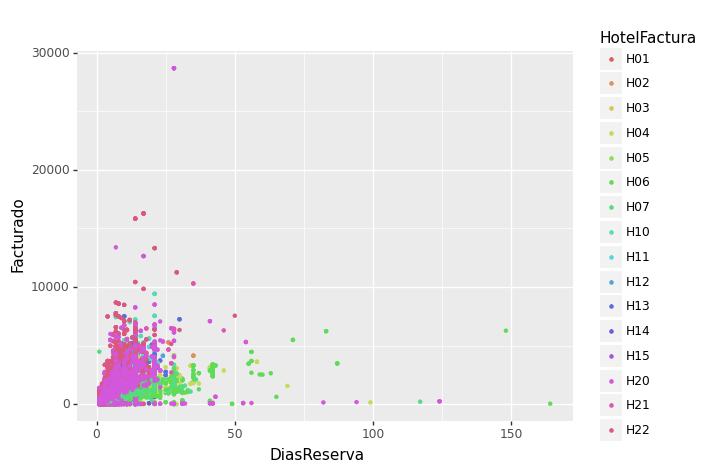

<ggplot: (8780148742253)>

In [51]:
(
    ggplot(dfCardexCleaned1) +
     geom_point(aes(x='DiasReserva', y = 'Facturado', color = 'HotelFactura'),
               alpha=1,
               shape='.',
               size = 3,
               stroke = 0.2) +
    labs( 
         x = 'DiasReserva',
         y = 'Facturado',
         color = 'HotelFactura')
)

/usr/local/lib/python3.7/dist-packages/plotnine/utils.py:1246: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if pdtypes.is_categorical(arr):
/usr/local/lib/python3.7/dist-packages/plotnine/stats/stat_boxplot.py:86: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if pdtypes.is_categorical(data['x']):
/usr/local/lib/python3.7/dist-packages/plotnine/stats/stat_boxplot.py:86: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if pdtypes.is_categorical(data['x']):
/usr/local/lib/python3.7/dist-packages/plotnine/stats/stat_boxplot.py:86: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if pdtypes.is_categorical(data['x']):
/usr/local/lib/python3.7/dist-packages/plotnine/stats/stat_boxplot.py:86: FutureWarni

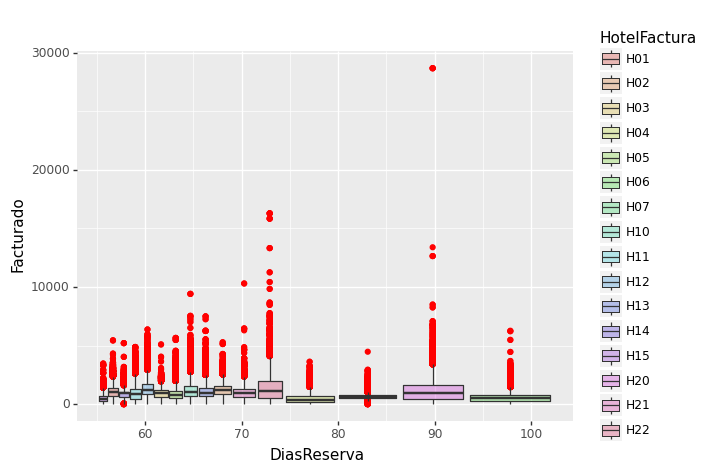

<ggplot: (8780136335045)>

In [52]:
(
    ggplot(dfCardexCleaned1) 
    + geom_boxplot(
        aes(x='DiasReserva', y = 'Facturado', fill = 'HotelFactura'),  
        alpha=0.4, 
        outlier_alpha = 1, 
        outlier_color ='red'
     )
   )

In [53]:
dfCardexCleaned1[dfCardexCleaned1["Facturado"]< 20]

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada
165,LGHHHGRWX,M,4/19/1948,DEU,mmagedanz@gmail.com,TGHRE170010373,1,1,H06,Salida,12/14/2017,1/11/2018,DBL,HB,2,0,0,0,SCHAUINSLAND/CAN,H06,DBL,HB,8/1/2017,NaN,NaN,15.80,True,69.00,28,135.00,12
166,L3H143MMH,F,9/27/1949,DEU,NaN,LZRE170032275,1,1,H04,Salida,12/14/2017,1/4/2018,DBVML,HB,2,0,0,0,ALLTOURS,H04,DBL,HB,8/17/2017,TTOO,NaN,2.46,False,68.00,21,119.00,12
167,252537890,M,4/7/1945,DEU,NaN,LZRE170032275,1,2,H04,Salida,12/14/2017,1/4/2018,DBVML,HB,2,0,0,0,ALLTOURS,H04,DBL,HB,8/17/2017,TTOO,NaN,2.46,False,72.00,21,119.00,12
168,LGHH1Y6F6,F,10/1/1947,DEU,mmagedanz@gmail.com,TGHRE170010373,1,2,H06,Salida,12/14/2017,1/11/2018,DBL,HB,2,0,0,0,SCHAUINSLAND/CAN,H06,DBL,HB,8/1/2017,NaN,NaN,15.80,True,70.00,28,135.00,12
207,L7ZGX7N5J,M,7/9/1947,DEU,NaN,TGHRE170011462,1,1,H06,Salida,12/19/2017,1/16/2018,DBL,BB,2,0,0,0,TUI DEUTSCHLAND GMBH,H06,DBL,BB,9/26/2017,TTOO,NaN,6.00,False,70.00,28,84.00,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
384406,48013830L,F,1/5/1991,ESP,NaN,H22RE210007764,1,1,H22,Salida,1/12/2021,1/15/2021,DBVM,BB,1,0,0,0,HI PARTNERS HOLDCO,H22,DBL,BB,1/8/2021,COMPLEMENTARY,DIRECTO CTA CASA,13.65,False,30.00,3,4.00,1
384835,5.92423E+11,F,9/26/1970,BEL,NaN,H20RE210008882,2,1,PRO,Salida,1/30/2021,2/13/2021,PROP,SC,3,0,0,0,DIRECTOS PROP,H20,DBL,SC,1/30/2021,DIRECT,NaN,15.00,False,51.00,14,0.00,1
384838,5.92897E+11,F,3/16/1993,BEL,NaN,H20RE210008882,2,2,PRO,Salida,1/30/2021,2/13/2021,PROP,SC,3,0,0,0,DIRECTOS PROP,H20,DBL,SC,1/30/2021,DIRECT,NaN,15.00,False,28.00,14,0.00,1
384839,5.92673E+11,F,5/4/1994,BEL,NaN,H20RE210008882,2,3,PRO,Salida,1/30/2021,2/13/2021,PROP,SC,3,0,0,0,DIRECTOS PROP,H20,DBL,SC,1/30/2021,DIRECT,NaN,15.00,False,27.00,14,0.00,1


In [54]:
dfCardexCleaned1["FacturadoXDia"] = dfCardexCleaned1["Facturado"] / dfCardexCleaned1["DiasReserva"]
dfCardexCleaned1

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,FacturadoXDia
3,03908922A,M,2/10/1984,ESP,NaN,TGHRE170006338,1,1,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,NaN,22.80,False,33.00,5,56.00,5,4.56
4,47077585N,F,4/28/1984,ESP,NaN,TGHRE170006338,1,2,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,NaN,22.80,False,33.00,5,56.00,5,4.56
78,1537926865,M,9/14/1929,DEU,NaN,LZRE170032022,1,1,H04,Salida,11/15/2017,2/22/2018,DBVM,HB,1,0,0,0,SCHAUINSLAND,H04,DUI,HB,8/2/2017,NaN,NaN,152.00,False,88.00,99,105.00,11,1.54
105,265327238,F,6/7/1969,DEU,FRENNA@EIRE.DE,LZRE170033051,1,1,H04,Salida,11/25/2017,11/30/2017,DBL,BB,2,0,0,0,SIDETOURS/ALEMAN,H04,DBL,BB,9/26/2017,NaN,NaN,22.90,True,48.00,5,60.00,11,4.58
106,L3R10H581,F,9/25/1995,DEU,FRENNA@EIRE.DE,LZRE170033051,1,2,H04,Salida,11/25/2017,11/30/2017,DBL,BB,2,0,0,0,SIDETOURS/ALEMAN,H04,DBL,BB,9/26/2017,NaN,NaN,22.90,True,22.00,5,60.00,11,4.58
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
386039,L1T1PRV55W,M,5/24/1971,DEU,NaN,H20RE210010231,1,2,H20,En Hotel,3/17/2021,3/20/2021,DBVMPC,BB,2,0,0,0,DIRECTO,H20,DBL,BB,3/15/2021,DIRECT,NaN,375.00,False,50.00,3,2.00,3,125.00
386040,JCL3X9E5,M,11/27/1990,LUX,NaN,H20RE210010325,1,2,H20,En Hotel,3/17/2021,3/24/2021,JSVMPC,HB,2,0,0,0,DIRECTO WEB AMIGO,H20,JSVMPC,HB,3/17/2021,DIRECT,NaN,2052.97,False,31.00,7,0.00,3,293.28
386041,C4YMXL71G,F,1/24/1991,GBR,dianakyllmann@gmail.com,H20RE210010317,1,2,H20,En Hotel,3/17/2021,3/18/2021,DBVMPC,BB,2,0,0,0,DIRECTO,H20,DBVMPC,BB,3/17/2021,DIRECT,NaN,215.66,True,30.00,1,0.00,3,215.66
386042,19E177251,M,6/29/1963,FRA,adsuarfamily@hotmail.fr,H20RE210010002,2,1,H20,En Hotel,3/17/2021,3/22/2021,DBVM,BB,2,0,0,0,BOOKING.COM B.V.,H20,DBVM,BB,3/10/2021,OTAS,NaN,1191.00,True,58.00,5,7.00,3,238.20


In [55]:
dfCardexCleaned1["FacturadoXDia"].quantile(0.005)

30.0

In [56]:
# dfCardexCleaned1[(dfCardexCleaned1["THFactura"]== "IND") & (dfCardexCleaned1["HotelFactura"]== "H01")]

# dfIncomesFixed[(dfCardexCleaned1["THFactura"]== "DBL") & (dfCardexCleaned1["HotelFactura"]== "H20")]["FacturadoXDia"].quantile(0.2)
# # supLimit = dfIncomesFixed[(dfCardexCleaned1["THFactura"]== "IND") & (dfCardexCleaned1["HotelFactura"]== "H01")]["FacturadoXDia"].quantile(0.98)
# # print(infLimit, supLimit)

In [57]:
dfIncomesFixed = dfCardexCleaned1.copy()

In [58]:

for hotel in dfIncomesFixed["HotelFactura"].unique():
  # print(hotel)

  for thFactura in dfIncomesFixed[dfIncomesFixed["HotelFactura"] == hotel]["THFactura"].unique():
    if(len(dfIncomesFixed[(dfIncomesFixed["HotelFactura"] == hotel) & (dfIncomesFixed["THFactura"] == thFactura)]["FacturadoXDia"])<2):
      continue
      
    infLimit = dfIncomesFixed[(dfIncomesFixed["HotelFactura"] == hotel) & (dfIncomesFixed["THFactura"] == thFactura)]["FacturadoXDia"].quantile(0.02)
    supLimit = dfIncomesFixed[(dfIncomesFixed["HotelFactura"] == hotel) & (dfIncomesFixed["THFactura"] == thFactura)]["FacturadoXDia"].quantile(0.98)

    mean = dfIncomesFixed[(dfIncomesFixed["HotelFactura"] == hotel) & (dfIncomesFixed["THFactura"] == thFactura) & (dfIncomesFixed["FacturadoXDia"] >= infLimit) & (dfIncomesFixed["FacturadoXDia"] <= supLimit)]["FacturadoXDia"].mean()
    std = dfIncomesFixed[(dfIncomesFixed["HotelFactura"] == hotel) & (dfIncomesFixed["THFactura"] == thFactura) & (dfIncomesFixed["FacturadoXDia"] >= infLimit) & (dfIncomesFixed["FacturadoXDia"] <= supLimit)]["FacturadoXDia"].std()

    # rellenando valores fuera de rango con distribucion normal
    dfIncomesFixed.loc[(dfIncomesFixed["HotelFactura"] == hotel) & (dfIncomesFixed["THFactura"] == thFactura) & (dfIncomesFixed["FacturadoXDia"] <= infLimit), ["FacturadoXDia"]] = np.random.normal(mean, std)
    # print(thFactura, infLimit, mean, std)

    # dfIncomesFixed.loc[(dfIncomesFixed["HotelFactura"] == hotel) & (dfIncomesFixed["THFactura"] == thFactura) & (dfIncomesFixed["FacturadoXDia"] <= infLimit), ["Facturado"]] = mean * dfIncomesFixed.loc[(dfIncomesFixed["HotelFactura"] == hotel) & (dfIncomesFixed["THFactura"] == thFactura) & (dfIncomesFixed["FacturadoXDia"] <= infLimit), ["DiasReserva"]]
    # dfIncomesFixed.loc[(dfIncomesFixed["HotelFactura"] == hotel) & (dfIncomesFixed["THFactura"] == thFactura) & (dfIncomesFixed["FacturadoXDia"] <= infLimit), ["FacturadoXDia"]] = mean
  # print("------------")




In [59]:
dfIncomesFixed.loc[:, ["Facturado"]] = dfIncomesFixed["FacturadoXDia"] * dfIncomesFixed["DiasReserva"]
dfIncomesFixed

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,FacturadoXDia
3,03908922A,M,2/10/1984,ESP,NaN,TGHRE170006338,1,1,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,NaN,288.04,False,33.00,5,56.00,5,57.61
4,47077585N,F,4/28/1984,ESP,NaN,TGHRE170006338,1,2,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,NaN,288.04,False,33.00,5,56.00,5,57.61
78,1537926865,M,9/14/1929,DEU,NaN,LZRE170032022,1,1,H04,Salida,11/15/2017,2/22/2018,DBVM,HB,1,0,0,0,SCHAUINSLAND,H04,DUI,HB,8/2/2017,NaN,NaN,5308.00,False,88.00,99,105.00,11,53.62
105,265327238,F,6/7/1969,DEU,FRENNA@EIRE.DE,LZRE170033051,1,1,H04,Salida,11/25/2017,11/30/2017,DBL,BB,2,0,0,0,SIDETOURS/ALEMAN,H04,DBL,BB,9/26/2017,NaN,NaN,662.19,True,48.00,5,60.00,11,132.44
106,L3R10H581,F,9/25/1995,DEU,FRENNA@EIRE.DE,LZRE170033051,1,2,H04,Salida,11/25/2017,11/30/2017,DBL,BB,2,0,0,0,SIDETOURS/ALEMAN,H04,DBL,BB,9/26/2017,NaN,NaN,662.19,True,22.00,5,60.00,11,132.44
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
386039,L1T1PRV55W,M,5/24/1971,DEU,NaN,H20RE210010231,1,2,H20,En Hotel,3/17/2021,3/20/2021,DBVMPC,BB,2,0,0,0,DIRECTO,H20,DBL,BB,3/15/2021,DIRECT,NaN,375.00,False,50.00,3,2.00,3,125.00
386040,JCL3X9E5,M,11/27/1990,LUX,NaN,H20RE210010325,1,2,H20,En Hotel,3/17/2021,3/24/2021,JSVMPC,HB,2,0,0,0,DIRECTO WEB AMIGO,H20,JSVMPC,HB,3/17/2021,DIRECT,NaN,2052.97,False,31.00,7,0.00,3,293.28
386041,C4YMXL71G,F,1/24/1991,GBR,dianakyllmann@gmail.com,H20RE210010317,1,2,H20,En Hotel,3/17/2021,3/18/2021,DBVMPC,BB,2,0,0,0,DIRECTO,H20,DBVMPC,BB,3/17/2021,DIRECT,NaN,215.66,True,30.00,1,0.00,3,215.66
386042,19E177251,M,6/29/1963,FRA,adsuarfamily@hotmail.fr,H20RE210010002,2,1,H20,En Hotel,3/17/2021,3/22/2021,DBVM,BB,2,0,0,0,BOOKING.COM B.V.,H20,DBVM,BB,3/10/2021,OTAS,NaN,1191.00,True,58.00,5,7.00,3,238.20


In [60]:
# for hotel in dfIncomesFixed["HotelFactura"].unique():
#   print(hotel)
#   for thFactura in dfIncomesFixed[dfIncomesFixed["HotelFactura"] == hotel]["THFactura"].unique():
#     infLimit = dfIncomesFixed[(dfIncomesFixed["HotelFactura"] == hotel) & (dfIncomesFixed["THFactura"] == thFactura)]["FacturadoXDia"].quantile(0.005)
#     mean = dfIncomesFixed[(dfIncomesFixed["HotelFactura"] == hotel) & (dfIncomesFixed["THFactura"] == thFactura) & (dfIncomesFixed["FacturadoXDia"] >= infLimit)]["FacturadoXDia"].mean()
#     std = dfIncomesFixed[(dfIncomesFixed["HotelFactura"] == hotel) & (dfIncomesFixed["THFactura"] == thFactura) & (dfIncomesFixed["FacturadoXDia"] >= infLimit)]["FacturadoXDia"].std()

#     print(thFactura, infLimit, mean, std)
#   print("------------")

#     # rellenando valores fuera de rango con distribucion normal

In [61]:
dfIncomesFixed[(dfIncomesFixed["FacturadoXDia"]< 70) & (dfIncomesFixed["HotelFactura"]== "H20")]

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,FacturadoXDia
345643,C7741085,F,5/25/1943,CHE,NaN,153626,1,1,H20,Salida,2/3/2020,2/15/2020,DBL,BB,1,0,0,0,KUONI /HELVETIC T.,H20,DBL,BB,1/27/2020,TTOO,NaN,785.40,False,77.00,12,7.00,2,65.45
346840,805760,M,10/20/1971,ESP,NaN,H20RE200000219,1,1,H20,Salida,2/8/2020,2/11/2020,DBL,BB,2,0,0,0,DIRECTO,H20,DBL,BB,2/7/2020,DIRECT,NaN,31.00,False,49.00,3,1.00,2,10.33
346899,553058880,F,6/8/1966,GBR,keren.lynn1966@gmail.com,152877,1,1,H20,Salida,2/8/2020,2/15/2020,DBVMPC,HB,2,0,0,0,BOOKING.COM B.V.,H20,DBL,HB,1/18/2020,OTAS,NaN,279.60,True,54.00,7,21.00,2,39.94
346936,C31RJMT2W,M,6/27/1963,DEU,NaN,137285,1,1,H20,Salida,2/8/2020,2/16/2020,DBL,HB,2,0,0,0,IKARUS TOURS GMBH,H20,DBL,HB,4/5/2019,TTOO,NaN,285.67,False,56.00,8,309.00,2,35.71
347005,AK0295150,F,1/1/1982,Eastern Africa,NaN,137285,1,2,H20,Salida,2/8/2020,2/16/2020,DBL,HB,2,0,0,0,IKARUS TOURS GMBH,H20,DBL,HB,4/5/2019,TTOO,NaN,285.67,False,37.00,8,309.00,2,35.71
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
384914,53201693W,M,8/21/1978,PRT,josevicenterodriguez@icav.es,H20RE210008944,3,1,H20,Salida,2/3/2021,2/5/2021,JST,BB,1,0,0,0,HI PARTNERS HOLDCO,H20,DBL,BB,2/2/2021,DIRECT,NaN,122.00,True,43.00,2,1.00,2,61.00
385115,31328623R,F,5/2/1963,ESP,anita.mapache@gmail.com,H20RE210009128,1,1,H20,Salida,2/12/2021,2/20/2021,DBL,BB,1,0,0,0,FILMCANARYISLANDS,H20,DBL,BB,2/10/2021,DIRECT,NaN,544.00,True,58.00,8,2.00,2,68.00
385131,25682414Q,F,7/25/1974,ESP,infoeva@gmail.com,H20RE210009128,2,1,H20,Salida,2/12/2021,2/18/2021,DBL,BB,1,0,0,0,FILMCANARYISLANDS,H20,DBL,BB,2/10/2021,DIRECT,NaN,408.00,True,47.00,6,2.00,2,68.00
385256,78518304F,M,1/8/1984,ESP,NaN,H20RE210009128,3,1,H20,Salida,2/16/2021,2/17/2021,DBL,BB,1,0,0,0,FILMCANARYISLANDS,H20,DBL,BB,2/10/2021,DIRECT,NaN,68.00,False,37.00,1,6.00,2,68.00


In [62]:
dfCardexCleaned1[(dfCardexCleaned1["HotelFactura"] == "H20") ]["FacturadoXDia"].quantile(0.02)


80.0

In [63]:
dfIncomesFixed[(dfIncomesFixed["HotelFactura"]== "H20")]['FacturadoXDia'].std()

96.49377449011008

/usr/local/lib/python3.7/dist-packages/plotnine/utils.py:1246: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if pdtypes.is_categorical(arr):


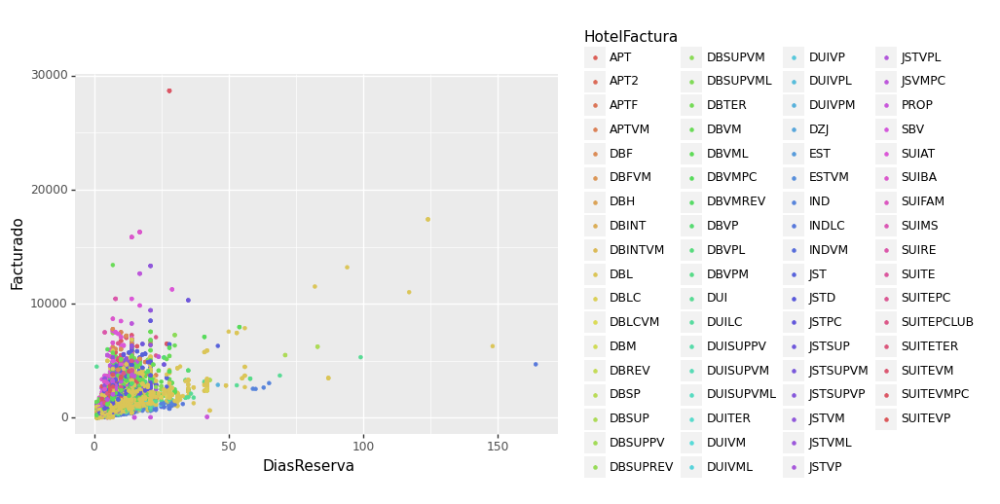

<ggplot: (8780132845785)>

In [64]:
(
    ggplot(dfIncomesFixed) +
     geom_point(aes(x='DiasReserva', y = 'Facturado', color = 'THFactura'),
               alpha=1,
               shape='.',
               size = 3,
               stroke = 0.2) +
    labs( 
         x = 'DiasReserva',
         y = 'Facturado',
         color = 'HotelFactura')
)

## GroupBy Reserva

In [65]:
dfIncomesFixed.head(10)

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,FacturadoXDia
3,03908922A,M,2/10/1984,ESP,NaN,TGHRE170006338,1,1,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,NaN,288.04,False,33.00,5,56.00,5,57.61
4,47077585N,F,4/28/1984,ESP,NaN,TGHRE170006338,1,2,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,NaN,288.04,False,33.00,5,56.00,5,57.61
78,1537926865,M,9/14/1929,DEU,NaN,LZRE170032022,1,1,H04,Salida,11/15/2017,2/22/2018,DBVM,HB,1,0,0,0,SCHAUINSLAND,H04,DUI,HB,8/2/2017,NaN,NaN,5308.00,False,88.00,99,105.00,11,53.62
105,265327238,F,6/7/1969,DEU,FRENNA@EIRE.DE,LZRE170033051,1,1,H04,Salida,11/25/2017,11/30/2017,DBL,BB,2,0,0,0,SIDETOURS/ALEMAN,H04,DBL,BB,9/26/2017,NaN,NaN,662.19,True,48.00,5,60.00,11,132.44
106,L3R10H581,F,9/25/1995,DEU,FRENNA@EIRE.DE,LZRE170033051,1,2,H04,Salida,11/25/2017,11/30/2017,DBL,BB,2,0,0,0,SIDETOURS/ALEMAN,H04,DBL,BB,9/26/2017,NaN,NaN,662.19,True,22.00,5,60.00,11,132.44
116,110710776,F,1/26/1948,DEU,INGRIDFISCHER@YAHOO.DE,LZRE170031213,1,1,H04,Salida,11/28/2017,1/9/2018,DBVML,HB,1,0,0,0,SCHAUINSLAND,H04,DUIVML,HB,6/13/2017,NaN,NaN,2400.96,True,69.00,42,168.00,11,57.17
118,L716167ZL,F,10/25/1929,DEU,NaN,LZRE170034435,1,1,H04,Salida,11/29/2017,1/21/2018,DBVPM,HB,1,0,0,0,DIRECTO,H04,DUI,HB,11/20/2017,DIRECT,NaN,2841.66,False,88.00,53,9.00,11,53.62
121,922154478,F,9/20/1927,AUT,hola@hola.com,TGHRE170012524,1,1,H06,Salida,12/1/2017,1/1/2018,DBL,HB,4,0,1,0,DIRECTO,H06,DBL,HB,11/30/2017,DIRECT,NaN,1785.87,True,90.00,31,1.00,12,57.61
122,P3192745,M,7/11/1951,AUT,h.lampel@bluewin.ch,TGHRE170012524,1,2,H06,Salida,12/1/2017,1/1/2018,DBL,HB,4,0,1,0,DIRECTO,H06,DBL,HB,11/30/2017,DIRECT,NaN,1785.87,True,66.00,31,1.00,12,57.61
123,P5885435,F,10/28/1959,AUT,NaN,TGHRE170012524,1,3,H06,Salida,12/1/2017,1/1/2018,DBL,HB,4,0,1,0,DIRECTO,H06,DBL,HB,11/30/2017,DIRECT,NaN,1785.87,False,58.00,31,1.00,12,57.61


In [66]:
dfIncomesFixed.isnull().sum()

Documento                    2051
Sexo                            0
FechaNacimiento              2934
PaisResidencia                  1
EMail                      235024
Reserva                         0
Linea                           0
Numero                          0
HotelUso                        0
Estado                          0
Entrada                         0
Salida                          0
THUso                           0
RegimenUso                      0
AD                              0
JR                              0
NI                              0
CU                              0
EntidadNegocio                  0
HotelFactura                    0
THFactura                       0
RegimenFactura                  0
Venta                           7
Canal                          83
Segmento                    66385
Facturado                       0
Has_Email                       0
Edad                         2941
DiasReserva                     0
DiasEntreReser

In [67]:
dfIncomesFixed[dfIncomesFixed["FechaNacimiento"].isnull()]

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,FacturadoXDia
268,NaN,M,NaN,DEU,NaN,TGHRE170006904,12,1,H06,Salida,12/21/2017,1/4/2018,DBL,HB,2,0,0,0,TRENDTOURS,H06,DBL,HB,3/17/2017,TTOO,NaN,984.30,False,nan,14,279.00,12,70.31
277,NaN,M,NaN,DEU,NaN,TGHRE170006904,16,2,H06,Salida,12/21/2017,1/4/2018,DBL,HBBI,2,0,0,0,TRENDTOURS,H06,DBL,HBBI,3/17/2017,TTOO,NaN,1036.00,False,nan,14,279.00,12,74.00
283,L6YXJ7J5C,M,NaN,DEU,NaN,TGHRE170006904,19,2,H06,Salida,12/21/2017,1/4/2018,DBL,HBBI,2,0,0,0,TRENDTOURS,H06,DBL,HBBI,3/17/2017,TTOO,NaN,1036.00,False,nan,14,279.00,12,74.00
291,NaN,M,NaN,DEU,NaN,TGHRE170006904,23,2,H06,Salida,12/21/2017,1/4/2018,DBL,HB,2,0,0,0,TRENDTOURS,H06,DBL,HB,3/17/2017,TTOO,NaN,966.00,False,nan,14,279.00,12,69.00
357,LCMV0GTKC,M,NaN,DEU,NaN,TGHRE170006904,57,2,H06,Salida,12/21/2017,1/4/2018,DBL,HBBI,2,0,0,0,TRENDTOURS,H06,DBL,HBBI,3/17/2017,TTOO,NaN,1036.00,False,nan,14,279.00,12,74.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
384634,46144755Q,M,NaN,ESP,NaN,H22RE210007850,2,1,H22,Salida,1/20/2021,1/21/2021,DBVM,BB,1,0,0,0,HI PARTNERS HOLDCO,H22,DBL,BB,1/18/2021,COMPLEMENTARY,NaN,57.45,False,nan,1,2.00,1,57.45
384955,25427874,M,NaN,LTU,indresakalauskaite95@gmail.com,H20RE210008785,1,1,H20,Salida,2/5/2021,2/8/2021,DBL,BB,2,0,0,0,NEO TRAVEL WORLD S.L,H20,DBL,BB,1/26/2021,TTOO,NaN,424.56,True,nan,3,10.00,2,141.52
385465,YA86777511,M,NaN,ITA,farmacia.pozza@libero.it,H20RE210009413,1,1,H20,Salida,2/24/2021,2/27/2021,DBVMPC,BB,1,0,0,0,DIRECTO WEB,H20,DBVM,BB,2/21/2021,DIRECT,NaN,529.00,True,nan,3,3.00,2,176.33
385497,42075335D,F,NaN,ESP,NaN,H20RE210009365,1,2,H20,Salida,2/25/2021,2/27/2021,JSVMPC,BB,2,0,0,0,BOOKING.COM B.V.,H20,JSVMPC,BB,2/19/2021,OTAS,NaN,503.60,False,nan,2,6.00,2,251.80


In [68]:
dfCardexCleaned2 = dfIncomesFixed.drop(["Segmento"], axis=1)

In [69]:
dfCardexCleaned2[dfCardexCleaned2["Canal"].isnull()]

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Facturado,Has_Email,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,FacturadoXDia
78,1537926865,M,9/14/1929,DEU,NaN,LZRE170032022,1,1,H04,Salida,11/15/2017,2/22/2018,DBVM,HB,1,0,0,0,SCHAUINSLAND,H04,DUI,HB,8/2/2017,NaN,5308.00,False,88.00,99,105.00,11,53.62
105,265327238,F,6/7/1969,DEU,FRENNA@EIRE.DE,LZRE170033051,1,1,H04,Salida,11/25/2017,11/30/2017,DBL,BB,2,0,0,0,SIDETOURS/ALEMAN,H04,DBL,BB,9/26/2017,NaN,662.19,True,48.00,5,60.00,11,132.44
106,L3R10H581,F,9/25/1995,DEU,FRENNA@EIRE.DE,LZRE170033051,1,2,H04,Salida,11/25/2017,11/30/2017,DBL,BB,2,0,0,0,SIDETOURS/ALEMAN,H04,DBL,BB,9/26/2017,NaN,662.19,True,22.00,5,60.00,11,132.44
116,110710776,F,1/26/1948,DEU,INGRIDFISCHER@YAHOO.DE,LZRE170031213,1,1,H04,Salida,11/28/2017,1/9/2018,DBVML,HB,1,0,0,0,SCHAUINSLAND,H04,DUIVML,HB,6/13/2017,NaN,2400.96,True,69.00,42,168.00,11,57.17
165,LGHHHGRWX,M,4/19/1948,DEU,mmagedanz@gmail.com,TGHRE170010373,1,1,H06,Salida,12/14/2017,1/11/2018,DBL,HB,2,0,0,0,SCHAUINSLAND/CAN,H06,DBL,HB,8/1/2017,NaN,1613.05,True,69.00,28,135.00,12,57.61
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1126,C2ZJ690NL,F,1/5/1983,DEU,NaN,LZRE170034653,1,2,H04,Salida,12/31/2017,1/7/2018,DBVML,HB,2,0,0,0,LTUR,H04,DBL,HB,11/28/2017,NaN,927.07,False,34.00,7,33.00,12,132.44
1157,869418787,F,8/10/1958,DEU,NaN,LZRE170033978,1,2,H04,Salida,12/31/2017,1/5/2018,DBVML,HB,2,0,0,0,FTI,H04,DBVML,HB,10/30/2017,NaN,369.71,False,59.00,5,62.00,12,73.94
382780,592074644,M,1/19/1971,BEL,NaN,H20RE200007876,1,1,H20,Salida,12/15/2020,12/17/2020,SUITEVMPC,HB,2,0,0,0,SPET TUR. TFE S.A.,H20,SUITEVMPC,HB,12/11/2020,NaN,399.75,False,49.00,2,4.00,12,199.88
382805,592518805,M,1/17/1966,BEL,yannic.demeyer@skynet.be,H20RE200007876,1,2,H20,Salida,12/15/2020,12/17/2020,SUITEVMPC,HB,2,0,0,0,SPET TUR. TFE S.A.,H20,SUITEVMPC,HB,12/11/2020,NaN,399.75,True,54.00,2,4.00,12,199.88


In [70]:
# dfCardexCleaned2 = dfCardexCleaned2.drop(["EntidadNegocio", "HotelUso"], axis=1)

In [71]:
dfCardexCleaned2.isnull().sum()

Documento                    2051
Sexo                            0
FechaNacimiento              2934
PaisResidencia                  1
EMail                      235024
Reserva                         0
Linea                           0
Numero                          0
HotelUso                        0
Estado                          0
Entrada                         0
Salida                          0
THUso                           0
RegimenUso                      0
AD                              0
JR                              0
NI                              0
CU                              0
EntidadNegocio                  0
HotelFactura                    0
THFactura                       0
RegimenFactura                  0
Venta                           7
Canal                          83
Facturado                       0
Has_Email                       0
Edad                         2941
DiasReserva                     0
DiasEntreReservaEntrada         7
MesEntrada    

In [72]:
dfCardexCleaned2[dfCardexCleaned2["Edad"].isnull()]

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Facturado,Has_Email,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,FacturadoXDia
268,NaN,M,NaN,DEU,NaN,TGHRE170006904,12,1,H06,Salida,12/21/2017,1/4/2018,DBL,HB,2,0,0,0,TRENDTOURS,H06,DBL,HB,3/17/2017,TTOO,984.30,False,nan,14,279.00,12,70.31
277,NaN,M,NaN,DEU,NaN,TGHRE170006904,16,2,H06,Salida,12/21/2017,1/4/2018,DBL,HBBI,2,0,0,0,TRENDTOURS,H06,DBL,HBBI,3/17/2017,TTOO,1036.00,False,nan,14,279.00,12,74.00
283,L6YXJ7J5C,M,NaN,DEU,NaN,TGHRE170006904,19,2,H06,Salida,12/21/2017,1/4/2018,DBL,HBBI,2,0,0,0,TRENDTOURS,H06,DBL,HBBI,3/17/2017,TTOO,1036.00,False,nan,14,279.00,12,74.00
291,NaN,M,NaN,DEU,NaN,TGHRE170006904,23,2,H06,Salida,12/21/2017,1/4/2018,DBL,HB,2,0,0,0,TRENDTOURS,H06,DBL,HB,3/17/2017,TTOO,966.00,False,nan,14,279.00,12,69.00
357,LCMV0GTKC,M,NaN,DEU,NaN,TGHRE170006904,57,2,H06,Salida,12/21/2017,1/4/2018,DBL,HBBI,2,0,0,0,TRENDTOURS,H06,DBL,HBBI,3/17/2017,TTOO,1036.00,False,nan,14,279.00,12,74.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
384634,46144755Q,M,NaN,ESP,NaN,H22RE210007850,2,1,H22,Salida,1/20/2021,1/21/2021,DBVM,BB,1,0,0,0,HI PARTNERS HOLDCO,H22,DBL,BB,1/18/2021,COMPLEMENTARY,57.45,False,nan,1,2.00,1,57.45
384955,25427874,M,NaN,LTU,indresakalauskaite95@gmail.com,H20RE210008785,1,1,H20,Salida,2/5/2021,2/8/2021,DBL,BB,2,0,0,0,NEO TRAVEL WORLD S.L,H20,DBL,BB,1/26/2021,TTOO,424.56,True,nan,3,10.00,2,141.52
385465,YA86777511,M,NaN,ITA,farmacia.pozza@libero.it,H20RE210009413,1,1,H20,Salida,2/24/2021,2/27/2021,DBVMPC,BB,1,0,0,0,DIRECTO WEB,H20,DBVM,BB,2/21/2021,DIRECT,529.00,True,nan,3,3.00,2,176.33
385497,42075335D,F,NaN,ESP,NaN,H20RE210009365,1,2,H20,Salida,2/25/2021,2/27/2021,JSVMPC,BB,2,0,0,0,BOOKING.COM B.V.,H20,JSVMPC,BB,2/19/2021,OTAS,503.60,False,nan,2,6.00,2,251.80


In [73]:
dfCardexCleaned2.loc[dfCardexCleaned2["Documento"] == "0", ["Documento"]] = dfCardexCleaned2.loc[dfCardexCleaned2["Documento"] == "0", ["Reserva"]]

# Limpiando valores de documento (algunos aparecian con 0, se les puso el numero de reserva)

In [74]:
grouped = dfCardexCleaned2.groupby(['Reserva', 'Linea']).agg(Sexo=pd.NamedAgg(column="Sexo", aggfunc="first"), PaisResidencia=pd.NamedAgg(column="PaisResidencia", aggfunc="first"), 
                                                    Documento = pd.NamedAgg(column="Documento", aggfunc="first"),
                                                    Entrada = pd.NamedAgg(column="Entrada", aggfunc="first"),
                                                    Salida = pd.NamedAgg(column="Salida", aggfunc="first"),
                                                    AD=pd.NamedAgg(column="AD", aggfunc="sum"),
                                                    JR=pd.NamedAgg(column="JR", aggfunc="sum"),
                                                    NI=pd.NamedAgg(column="NI", aggfunc="sum"),
                                                    CU=pd.NamedAgg(column="CU", aggfunc="sum"),
                                                    HotelFactura=pd.NamedAgg(column="HotelFactura", aggfunc="first"),
                                                    THFactura=pd.NamedAgg(column="THFactura", aggfunc="first"),
                                                    RegimenFactura=pd.NamedAgg(column="RegimenFactura", aggfunc="first"),
                                                    Canal=pd.NamedAgg(column="Canal", aggfunc="first"),
                                                    Has_Email=pd.NamedAgg(column="Has_Email", aggfunc="any"),
                                                    Facturado=pd.NamedAgg(column="Facturado", aggfunc="sum"),
                                                    Edad=pd.NamedAgg(column="Edad", aggfunc="first"),
                                                    DiasReserva=pd.NamedAgg(column="DiasReserva", aggfunc="first"),
                                                    DiasEntreReservaEntrada=pd.NamedAgg(column="DiasEntreReservaEntrada", aggfunc="first"),
                                                    MesEntrada=pd.NamedAgg(column="MesEntrada", aggfunc="first"),
                                                    NumeroHabitaciones = pd.NamedAgg(column="Linea", aggfunc="count"))


In [75]:
grouped

,,Sexo,PaisResidencia,Documento,Entrada,Salida,AD,JR,NI,CU,HotelFactura,THFactura,RegimenFactura,Canal,Has_Email,Facturado,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,NumeroHabitaciones
Reserva,Linea,,,,,,,,,,,,,,,,,,,,
2020/00016,1,M,DEU,L6WLFNM8L,2/1/2020,2/7/2020,4,0,0,0,H22,DBL,BB,TTOO,False,2105.78,56.00,6,352.00,2,2
2020/00020,1,F,GBR,519702893,2/1/2020,2/4/2020,4,0,0,0,H21,JSTSUP,AI,TTOO,False,960.00,68.00,3,362.00,2,2
2020/00035,1,M,DEU,C9038Z0PN,2/4/2020,2/13/2020,4,0,0,0,H22,DBVM,BB,DIRECT,False,7773.54,78.00,9,315.00,2,2
2020/00049,1,F,NOR,31277024,2/1/2020,2/2/2020,4,0,0,0,H21,JSTSUP,AI,TTOO,False,309.68,64.00,1,329.00,2,2
2020/00062,1,F,GBR,538118225,2/7/2020,2/14/2020,4,0,0,0,H21,JSTSUP,AI,ONLINE,False,2352.00,49.00,7,322.00,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TNRE190021957,2,M,FRA,1.20362E+11,6/30/2019,7/7/2019,4,0,0,0,H05,DBL,AI,TTOO,False,1873.20,22.00,7,118.00,6,2
TNRE190021959,1,M,FRA,12030230 688,9/22/2019,9/29/2019,4,0,0,0,H05,DBL,AI,TTOO,False,1695.12,50.00,7,202.00,9,2
TNRE190021960,1,M,FRA,1.4126E+11,7/6/2019,7/20/2019,4,0,2,0,H05,DBL,AI,TTOO,False,3706.80,37.00,14,124.00,7,2


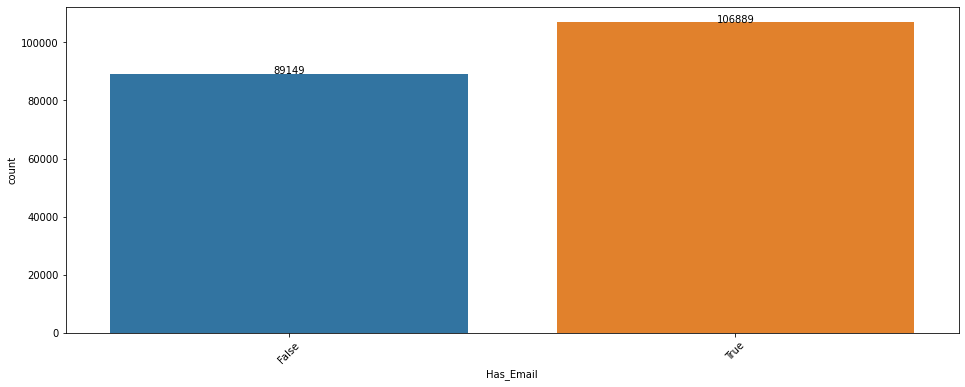

In [76]:
plt.figure(figsize=(16, 6))


chart = sns.countplot(x='Has_Email', data=grouped)
chart.set_xticklabels(chart.get_xticklabels(), rotation=45)

for p in chart.patches:
    height = p.get_height()
    chart.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

In [77]:
groupedWithPositiveIncomes = grouped[grouped["Facturado"] > 0]

In [78]:
# limpiando columna facturados

groupedWithPositiveIncomes["NumeroHabitaciones"] = pd.to_numeric(groupedWithPositiveIncomes["NumeroHabitaciones"], errors="coerce", downcast="signed")

groupedWithPositiveIncomes["FacturadoXHab"] = groupedWithPositiveIncomes["Facturado"] / (groupedWithPositiveIncomes["NumeroHabitaciones"] * groupedWithPositiveIncomes["DiasReserva"])

In [79]:
groupedWithPositiveIncomes[groupedWithPositiveIncomes["FacturadoXHab"] >1000]

,,Sexo,PaisResidencia,Documento,Entrada,Salida,AD,JR,NI,CU,HotelFactura,THFactura,RegimenFactura,Canal,Has_Email,Facturado,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,NumeroHabitaciones,FacturadoXHab
Reserva,Linea,,,,,,,,,,,,,,,,,,,,,
2020/00261,1,M,USA,534812922,2/11/2020,2/15/2020,4,0,4,0,H22,SUIRE,BB,DIRECT,False,14973.92,46.00,4,191.00,2,2,1871.74
2020/00803,1,F,NLD,NRFPROL68,2/1/2020,2/2/2020,4,0,0,0,H22,JSTVM,BB,TTOO,False,2176.14,65.00,1,97.00,2,2,1088.07
2020/03322,1,M,GBR,X5977452M,2/1/2020,2/2/2020,4,0,0,0,H22,DBVM,BB,DIRECT,False,2707.44,56.00,1,4.00,2,2,1353.72
152532,1,M,GBR,801298101,2/14/2020,2/19/2020,16,0,0,0,H20,JSVMPC,BB,DIRECT,True,21941.36,53.00,5,32.00,2,4,1097.07
H07RE200013445,1,M,ESP,31864893A,10/19/2020,10/20/2020,1,0,0,0,H07,DUI,AI,AGENCY,False,4480.00,46.00,1,2.00,10,1,4480.00
H10RE180005302,1,F,GBR,526251064,6/3/2018,6/10/2018,4,0,0,0,H10,DBSUPVM,BB,TTOO,False,14877.24,83.00,7,27.00,6,2,1062.66
H13RE190016785,2,F,NLD,NW94P2FB9,9/28/2019,9/29/2019,3,0,0,0,H13,APTVM,BB,DIRECT,True,1136.83,65.00,1,105.00,9,1,1136.83
H13RE190017938,2,F,DEU,Y0766394,9/24/2019,9/25/2019,4,0,0,0,H13,DBLCVM,AI,DIRECT,True,2334.32,34.00,1,74.00,9,2,1167.16
H13RE190018707,2,M,DEU,L7ZR16RH8,9/30/2019,10/1/2019,2,0,0,0,H13,DBLCVM,HB,DIRECT,False,1016.05,33.00,1,62.00,9,1,1016.05


In [80]:
groupedWithPositiveIncomes[groupedWithPositiveIncomes["DiasReserva"] > 0].describe()

,AD,JR,NI,CU,Facturado,Edad,DiasReserva,DiasEntreReservaEntrada,NumeroHabitaciones,FacturadoXHab
count,196038.00,196038.00,196038.00,196038.00,196038.00,195423.00,196038.00,196034.00,196038.00,196038.00
mean,4.02,0.02,0.35,0.07,1865.52,45.86,6.86,91.49,1.95,134.15
std,1.88,0.23,1.00,0.39,1519.08,35.67,3.31,92.57,0.46,68.24
min,0.00,0.00,0.00,0.00,2.25,-7787.00,1.00,-192.00,1.00,1.73
25%,4.00,0.00,0.00,0.00,921.56,32.00,5.00,20.00,2.00,84.00
50%,4.00,0.00,0.00,0.00,1585.40,46.00,7.00,60.00,2.00,124.60
75%,4.00,0.00,0.00,0.00,2424.80,59.00,7.00,136.00,2.00,169.99
max,100.00,15.00,16.00,8.00,114691.72,118.00,164.00,853.00,10.00,4480.00


In [81]:
groupedWithPositiveIncomes.isnull().sum()

Sexo                         0
PaisResidencia               0
Documento                  524
Entrada                      0
Salida                       0
AD                           0
JR                           0
NI                           0
CU                           0
HotelFactura                 0
THFactura                    0
RegimenFactura               0
Canal                       48
Has_Email                    0
Facturado                    0
Edad                       615
DiasReserva                  0
DiasEntreReservaEntrada      4
MesEntrada                   0
NumeroHabitaciones           0
FacturadoXHab                0
dtype: int64

In [82]:
groupedIncAgeCleaned = groupedWithPositiveIncomes[groupedWithPositiveIncomes["Edad"]>18]   #solo con los mayores de edad

In [83]:
groupedIncAgeCleaned.isnull().sum()

Sexo                         0
PaisResidencia               0
Documento                  202
Entrada                      0
Salida                       0
AD                           0
JR                           0
NI                           0
CU                           0
HotelFactura                 0
THFactura                    0
RegimenFactura               0
Canal                       48
Has_Email                    0
Facturado                    0
Edad                         0
DiasReserva                  0
DiasEntreReservaEntrada      0
MesEntrada                   0
NumeroHabitaciones           0
FacturadoXHab                0
dtype: int64

In [84]:
groupedIncAgeCleaned = groupedIncAgeCleaned[groupedIncAgeCleaned["Edad"]<100]

In [85]:
groupedIncAgeCleaned.describe()

,AD,JR,NI,CU,Facturado,Edad,DiasReserva,DiasEntreReservaEntrada,NumeroHabitaciones,FacturadoXHab
count,191300.00,191300.00,191300.00,191300.00,191300.00,191300.00,191300.00,191300.00,191300.00,191300.00
mean,4.02,0.02,0.36,0.07,1866.67,46.67,6.86,91.43,1.95,134.25
std,1.86,0.22,1.00,0.39,1521.43,16.12,3.30,92.59,0.46,68.26
min,0.00,0.00,0.00,0.00,2.25,19.00,1.00,-192.00,1.00,1.73
25%,4.00,0.00,0.00,0.00,921.84,33.00,5.00,20.00,2.00,84.00
50%,4.00,0.00,0.00,0.00,1589.12,47.00,7.00,60.00,2.00,124.86
75%,4.00,0.00,0.00,0.00,2424.00,59.00,7.00,136.00,2.00,170.05
max,100.00,15.00,16.00,8.00,114691.72,99.00,148.00,853.00,10.00,4480.00


In [86]:
groupedIncAgeCleaned[groupedIncAgeCleaned["DiasReserva"]==148]

,,Sexo,PaisResidencia,Documento,Entrada,Salida,AD,JR,NI,CU,HotelFactura,THFactura,RegimenFactura,Canal,Has_Email,Facturado,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,NumeroHabitaciones,FacturadoXHab
Reserva,Linea,,,,,,,,,,,,,,,,,,,,,
H06RE190003662,1,F,DEU,LGPF5VP2X,10/22/2019,3/18/2020,1,0,0,0,H06,DBL,HB,DIRECT,True,6272.40,83.00,148,119.00,10,1,42.38


# RFM (total facturado)

In [87]:
groupedForRfmDf = groupedIncAgeCleaned.copy()

In [88]:
groupedForRfmDf

,,Sexo,PaisResidencia,Documento,Entrada,Salida,AD,JR,NI,CU,HotelFactura,THFactura,RegimenFactura,Canal,Has_Email,Facturado,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,NumeroHabitaciones,FacturadoXHab
Reserva,Linea,,,,,,,,,,,,,,,,,,,,,
2020/00016,1,M,DEU,L6WLFNM8L,2/1/2020,2/7/2020,4,0,0,0,H22,DBL,BB,TTOO,False,2105.78,56.00,6,352.00,2,2,175.48
2020/00020,1,F,GBR,519702893,2/1/2020,2/4/2020,4,0,0,0,H21,JSTSUP,AI,TTOO,False,960.00,68.00,3,362.00,2,2,160.00
2020/00035,1,M,DEU,C9038Z0PN,2/4/2020,2/13/2020,4,0,0,0,H22,DBVM,BB,DIRECT,False,7773.54,78.00,9,315.00,2,2,431.86
2020/00049,1,F,NOR,31277024,2/1/2020,2/2/2020,4,0,0,0,H21,JSTSUP,AI,TTOO,False,309.68,64.00,1,329.00,2,2,154.84
2020/00062,1,F,GBR,538118225,2/7/2020,2/14/2020,4,0,0,0,H21,JSTSUP,AI,ONLINE,False,2352.00,49.00,7,322.00,2,2,168.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TNRE190021957,2,M,FRA,1.20362E+11,6/30/2019,7/7/2019,4,0,0,0,H05,DBL,AI,TTOO,False,1873.20,22.00,7,118.00,6,2,133.80
TNRE190021959,1,M,FRA,12030230 688,9/22/2019,9/29/2019,4,0,0,0,H05,DBL,AI,TTOO,False,1695.12,50.00,7,202.00,9,2,121.08
TNRE190021960,1,M,FRA,1.4126E+11,7/6/2019,7/20/2019,4,0,2,0,H05,DBL,AI,TTOO,False,3706.80,37.00,14,124.00,7,2,132.39


In [89]:
def getAmountOfDaysSinceLastBooking(row):
  if(row.isnull().any()):
    return "NaN"
  return amountOfDays(row["Entrada"], "4/30/2021")

groupedForRfmDf["DiasDesdeUltimaReserva"] = groupedForRfmDf[["Entrada", "Salida"]].apply(getAmountOfDaysSinceLastBooking, axis=1)

groupedForRfmDf

,,Sexo,PaisResidencia,Documento,Entrada,Salida,AD,JR,NI,CU,HotelFactura,THFactura,RegimenFactura,Canal,Has_Email,Facturado,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,NumeroHabitaciones,FacturadoXHab,DiasDesdeUltimaReserva
Reserva,Linea,,,,,,,,,,,,,,,,,,,,,,
2020/00016,1,M,DEU,L6WLFNM8L,2/1/2020,2/7/2020,4,0,0,0,H22,DBL,BB,TTOO,False,2105.78,56.00,6,352.00,2,2,175.48,454
2020/00020,1,F,GBR,519702893,2/1/2020,2/4/2020,4,0,0,0,H21,JSTSUP,AI,TTOO,False,960.00,68.00,3,362.00,2,2,160.00,454
2020/00035,1,M,DEU,C9038Z0PN,2/4/2020,2/13/2020,4,0,0,0,H22,DBVM,BB,DIRECT,False,7773.54,78.00,9,315.00,2,2,431.86,451
2020/00049,1,F,NOR,31277024,2/1/2020,2/2/2020,4,0,0,0,H21,JSTSUP,AI,TTOO,False,309.68,64.00,1,329.00,2,2,154.84,454
2020/00062,1,F,GBR,538118225,2/7/2020,2/14/2020,4,0,0,0,H21,JSTSUP,AI,ONLINE,False,2352.00,49.00,7,322.00,2,2,168.00,448
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TNRE190021957,2,M,FRA,1.20362E+11,6/30/2019,7/7/2019,4,0,0,0,H05,DBL,AI,TTOO,False,1873.20,22.00,7,118.00,6,2,133.80,670
TNRE190021959,1,M,FRA,12030230 688,9/22/2019,9/29/2019,4,0,0,0,H05,DBL,AI,TTOO,False,1695.12,50.00,7,202.00,9,2,121.08,586
TNRE190021960,1,M,FRA,1.4126E+11,7/6/2019,7/20/2019,4,0,2,0,H05,DBL,AI,TTOO,False,3706.80,37.00,14,124.00,7,2,132.39,664


In [90]:
groupedForRfmDf.describe()

,AD,JR,NI,CU,Facturado,Edad,DiasReserva,DiasEntreReservaEntrada,NumeroHabitaciones,FacturadoXHab,DiasDesdeUltimaReserva
count,191300.00,191300.00,191300.00,191300.00,191300.00,191300.00,191300.00,191300.00,191300.00,191300.00,191300.00
mean,4.02,0.02,0.36,0.07,1866.67,46.67,6.86,91.43,1.95,134.25,784.71
std,1.86,0.22,1.00,0.39,1521.43,16.12,3.30,92.59,0.46,68.26,259.82
min,0.00,0.00,0.00,0.00,2.25,19.00,1.00,-192.00,1.00,1.73,44.00
25%,4.00,0.00,0.00,0.00,921.84,33.00,5.00,20.00,2.00,84.00,612.00
50%,4.00,0.00,0.00,0.00,1589.12,47.00,7.00,60.00,2.00,124.86,749.00
75%,4.00,0.00,0.00,0.00,2424.00,59.00,7.00,136.00,2.00,170.05,1013.00
max,100.00,15.00,16.00,8.00,114691.72,99.00,148.00,853.00,10.00,4480.00,1460.00


In [91]:
groupedForRfmDf[groupedForRfmDf["DiasDesdeUltimaReserva"] < 45]

Sexo PaisResidencia  ... FacturadoXHab DiasDesdeUltimaReserva
Reserva        Linea                      ...                                     
H20RE210009667 1        M            ESP  ...        191.90                     44
H20RE210009745 1        M            DEU  ...        389.00                     44
H20RE210009871 1        M            NLD  ...        232.20                     44
H20RE210010002 1        M            FRA  ...        238.20                     44
               2        M            FRA  ...        238.20                     44
H20RE210010115 1        M            ESP  ...        153.00                     44
H20RE210010193 1        M            EST  ...        141.67                     44
H20RE210010231 1        M            DEU  ...        125.00                     44
H20RE210010272 1        M            FRA  ...        148.80                     44
H20RE210010317 1        M            BEL  ...        215.66                     44
H20RE210010325 1        M            LUX  ...        293.28                     44

[11 rows x 22 columns]

### Reservas por año

In [92]:

groupedForRfmDf["Year"] = groupedForRfmDf["Entrada"].apply(lambda date: date.split("/")[2])



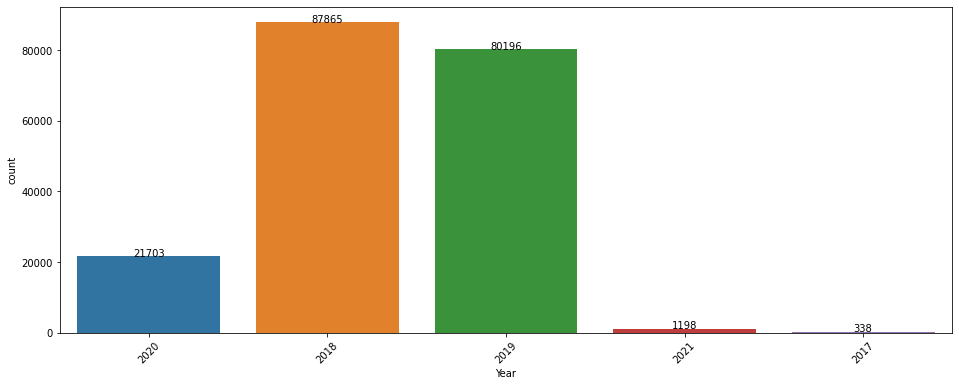

In [93]:
plt.figure(figsize=(16, 6))


chart = sns.countplot(x='Year', data=groupedForRfmDf)
chart.set_xticklabels(chart.get_xticklabels(), rotation=45)

for p in chart.patches:
    height = p.get_height()
    chart.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

### GroupBy by client

In [94]:
groupedByClient = groupedForRfmDf.groupby(['Documento']).agg(Sexo=pd.NamedAgg(column="Sexo", aggfunc="first"), PaisResidencia=pd.NamedAgg(column="PaisResidencia", aggfunc="first"), 
                                                    AD=pd.NamedAgg(column="AD", aggfunc="sum"),
                                                    JR=pd.NamedAgg(column="JR", aggfunc="sum"),
                                                    NI=pd.NamedAgg(column="NI", aggfunc="sum"),
                                                    CU=pd.NamedAgg(column="CU", aggfunc="sum"),
                                                    HotelFactura=pd.NamedAgg(column="HotelFactura", aggfunc="first"),
                                                    THFactura=pd.NamedAgg(column="THFactura", aggfunc="first"),
                                                    RegimenFactura=pd.NamedAgg(column="RegimenFactura", aggfunc="first"),
                                                    Canal=pd.NamedAgg(column="Canal", aggfunc="first"),
                                                    Facturado=pd.NamedAgg(column="Facturado", aggfunc="sum"),
                                                    Edad=pd.NamedAgg(column="Edad", aggfunc="first"),
                                                    DiasReserva=pd.NamedAgg(column="DiasReserva", aggfunc="sum"),
                                                    DiasReservaMedia = pd.NamedAgg(column="DiasReserva", aggfunc="mean"),
                                                    DiasEntreReservaEntrada=pd.NamedAgg(column="DiasEntreReservaEntrada", aggfunc="mean"),
                                                    MesEntrada=pd.NamedAgg(column="MesEntrada", aggfunc="first"),
                                                    DiasDesdeUltimaReserva = pd.NamedAgg(column="DiasDesdeUltimaReserva", aggfunc="min"),
                                                    DiasDesdePrimeraReserva = pd.NamedAgg(column="DiasDesdeUltimaReserva", aggfunc="max"),
                                                    NumeroHabitaciones = pd.NamedAgg(column="NumeroHabitaciones", aggfunc="sum"),
                                                    FacturadoXHabMaxReserva = pd.NamedAgg(column="FacturadoXHab", aggfunc="max"),
                                                    NumeroReservas = pd.NamedAgg(column="Documento", aggfunc="count"),
                                                    )

groupedByClient

,Sexo,PaisResidencia,AD,JR,NI,CU,HotelFactura,THFactura,RegimenFactura,Canal,Facturado,Edad,DiasReserva,DiasReservaMedia,DiasEntreReservaEntrada,MesEntrada,DiasDesdeUltimaReserva,DiasDesdePrimeraReserva,NumeroHabitaciones,FacturadoXHabMaxReserva,NumeroReservas
Documento,,,,,,,,,,,,,,,,,,,,,
43804825Z,M,ESP,4,2,0,2,H20,DBL,HB,ONLINE,750.00,47.00,2,2.00,6.00,8,262,262,2.00,187.50,1
P71469453,M,DEU,1,0,0,0,H02,DBL,HB,DIRECT,1747.46,61.00,10,10.00,126.00,5,1087,1087,1.00,174.75,1
-1.145966,M,DEU,4,0,0,0,H04,DBL,BB,AGENCY,833.60,29.00,4,4.00,85.00,7,669,669,2.00,104.20,1
-4.2096E+11,M,FRA,4,0,0,0,H07,DBL,AI,TTOO,1600.00,36.00,7,7.00,81.00,12,495,495,2.00,114.29,1
.--411P17.-111:21111,M,GBR,4,0,0,0,H05,DBL,AI,TTOO,1975.40,32.00,7,7.00,82.00,7,666,666,2.00,141.10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
l2554652B,M,DEU,4,0,0,0,H01,DBL,AI,TTOO,2445.80,23.00,7,7.00,60.00,6,1046,1046,2.00,174.70,1
l369857254,F,DEU,4,0,0,0,H01,DBL,HB,TTOO,1795.92,23.00,6,6.00,193.00,8,629,629,2.00,149.66,1
l58685742,M,AUT,4,0,0,0,H01,DBL,AI,TTOO,2439.36,24.00,6,6.00,108.00,8,629,629,2.00,203.28,1


In [95]:
groupedByClient["FacturadoXHab"] = groupedByClient["Facturado"]/(groupedByClient["DiasReserva"] * groupedByClient["NumeroHabitaciones"])

In [96]:
groupedForRfmDf["Facturado"].sum()

357093572.70072335

In [97]:
groupedByClient["Facturado"].sum()

356807267.42472106

In [98]:
dfCardexCleaned2["Facturado"].sum()

365712874.82236373

In [99]:
groupedByClient.info()

<class 'pandas.core.frame.DataFrame'>
Index: 176320 entries,  43804825Z  to º205343836
Data columns (total 22 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   Sexo                     176320 non-null  object 
 1   PaisResidencia           176320 non-null  object 
 2   AD                       176320 non-null  int64  
 3   JR                       176320 non-null  int64  
 4   NI                       176320 non-null  int64  
 5   CU                       176320 non-null  int64  
 6   HotelFactura             176320 non-null  object 
 7   THFactura                176320 non-null  object 
 8   RegimenFactura           176320 non-null  object 
 9   Canal                    176280 non-null  object 
 10  Facturado                176320 non-null  float64
 11  Edad                     176320 non-null  float64
 12  DiasReserva              176320 non-null  int16  
 13  DiasReservaMedia         176320 non-null  float64


In [100]:
groupedByClient[groupedByClient["NumeroReservas"]> 1]

,Sexo,PaisResidencia,AD,JR,NI,CU,HotelFactura,THFactura,RegimenFactura,Canal,Facturado,Edad,DiasReserva,DiasReservaMedia,DiasEntreReservaEntrada,MesEntrada,DiasDesdeUltimaReserva,DiasDesdePrimeraReserva,NumeroHabitaciones,FacturadoXHabMaxReserva,NumeroReservas,FacturadoXHab
Documento,,,,,,,,,,,,,,,,,,,,,,
00194693K,M,ESP,12,0,0,0,H06,DBL,HB,OTAS,4924.50,80.00,27,9.00,24.67,3,991,1147,6.00,97.09,3,30.40
00403877C,M,ESP,3,0,0,0,H04,DUI,BB,DIRECT,567.91,56.00,7,2.33,4.67,3,767,844,3.00,114.43,3,27.04
00662428M,F,ESP,8,0,0,0,H07,DBL,AI,OTAS,1163.04,62.00,5,2.50,93.50,10,547,549,4.00,116.84,2,58.15
00685805Z,M,ESP,8,0,0,0,H20,JSVMPC,BB,ONLINE,1714.74,61.00,4,2.00,6.50,10,202,231,4.00,265.26,2,107.17
00820048Y,M,ESP,2,0,0,0,H04,DUI,BB,OTAS,177.91,53.00,3,1.50,14.50,4,752,886,2.00,60.63,2,29.65
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
YC901654,F,DEU,4,0,0,0,H20,JSTPC,BB,AGENCY,2365.35,33.00,17,4.25,19.75,11,85,156,4.00,166.69,4,34.78
Z01YH4PJV,M,DEU,8,0,0,0,H04,DBVPM,BB,TTOO,871.14,36.00,4,2.00,2.50,6,670,673,4.00,118.17,2,54.45
Z2641563,M,Southern Asia,2,0,0,0,H04,DUI,BB,AGENCY,576.43,38.00,8,4.00,6.00,5,914,1091,2.00,87.80,2,36.03


In [101]:
dfCardexCleaned1[dfCardexCleaned1["Documento"] == "Z4911941"]

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Segmento,Facturado,Has_Email,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,FacturadoXDia
184162,Z4911941,M,2/8/1977,Southern Asia,ASHISHHARRISON77@GMAIL.COM,LZRE190047095,3,1,H04,Salida,2/22/2019,3/23/2019,DBL,BB,1,0,0,0,HOTELBEDS PRODUCT SL,H04,DUI,BB,2/10/2019,ONLINE,VACACIONAL,6.60,True,42.00,29,12.00,2,0.23
187717,Z4911941,M,2/8/1977,Southern Asia,ASHISHHARRISON77@GMAIL.COM,H04RE190000433,1,1,H04,Salida,3/23/2019,3/30/2019,DBL,BB,1,0,0,0,HOTELBEDS PRODUCT SL,H04,DUI,BB,3/15/2019,ONLINE,AGENCIAS,373.31,True,42.00,7,8.00,3,53.33


In [102]:
groupedByClient.describe()

,AD,JR,NI,CU,Facturado,Edad,DiasReserva,DiasReservaMedia,DiasEntreReservaEntrada,DiasDesdeUltimaReserva,DiasDesdePrimeraReserva,NumeroHabitaciones,FacturadoXHabMaxReserva,NumeroReservas,FacturadoXHab
count,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00
mean,4.36,0.02,0.39,0.08,2023.63,46.53,7.44,6.88,92.12,777.82,792.54,2.12,136.55,1.08,131.42
std,2.74,0.24,1.10,0.42,1806.24,16.17,5.06,3.14,92.08,258.46,258.67,1.05,68.94,0.53,67.95
min,0.00,0.00,0.00,0.00,8.60,19.00,1.00,1.00,-60.50,44.00,44.00,1.00,1.73,1.00,0.94
25%,4.00,0.00,0.00,0.00,981.76,33.00,5.00,5.00,21.00,608.00,616.00,2.00,85.89,1.00,81.00
50%,4.00,0.00,0.00,0.00,1678.31,46.00,7.00,7.00,61.00,734.00,769.00,2.00,126.61,1.00,122.68
75%,4.00,0.00,0.00,0.00,2550.29,59.00,7.00,7.00,136.00,1008.00,1018.00,2.00,172.81,1.00,168.50
max,329.00,15.00,55.00,13.00,118451.54,99.00,461.00,94.00,853.00,1460.00,1460.00,151.00,4480.00,71.00,1871.74


In [103]:
groupedByClient[groupedByClient["FacturadoXHab"] < 10]

,Sexo,PaisResidencia,AD,JR,NI,CU,HotelFactura,THFactura,RegimenFactura,Canal,Facturado,Edad,DiasReserva,DiasReservaMedia,DiasEntreReservaEntrada,MesEntrada,DiasDesdeUltimaReserva,DiasDesdePrimeraReserva,NumeroHabitaciones,FacturadoXHabMaxReserva,NumeroReservas,FacturadoXHab
Documento,,,,,,,,,,,,,,,,,,,,,,
05418120X,F,ESP,9,0,0,0,H04,DBVPM,BB,DIRECT,521.04,36.00,10,1.11,2.78,3,787,1166,9.00,59.07,9,5.79
09047036D,F,ESP,16,0,0,0,H06,DBL,BB,OTAS,938.32,38.00,19,2.71,19.57,6,606,1081,10.00,49.25,7,4.94
1.0016E+11,F,FRA,40,0,2,0,H05,DBL,AI,TTOO,13771.80,60.00,75,7.50,96.70,5,518,1179,20.00,133.80,10,9.18
1.0046E+11,F,FRA,52,4,2,0,H02,DBVP,BB,TTOO,19516.98,36.00,91,7.00,90.31,8,462,1095,26.00,232.16,13,8.25
1.0106E+11,M,FRA,59,1,6,3,H06,DBL,AI,TTOO,18767.30,46.00,86,6.62,80.38,10,559,1172,27.00,187.86,13,8.08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
P2981903,M,AUT,9,0,0,0,H04,DUI,BB,AGENCY,1764.09,55.00,35,3.89,3.44,1,793,1188,9.00,59.31,9,5.60
PE1515344,M,GBR,329,0,37,10,H02,DBVP,HB,ONLINE,118451.54,37.00,408,5.75,63.21,9,569,768,151.00,264.86,71,1.92
PT5058990,M,ESP,13,0,0,0,H04,DUI,BB,DIRECT,1052.73,38.00,14,1.40,4.30,3,768,1184,11.00,84.55,10,6.84


### Frequency

In [104]:
def getFrequency(row):
  if row["NumeroReservas"] > 4:
    return 5
  if row["NumeroReservas"] > 3:
    return 4
  if row["NumeroReservas"] > 2:
    return 3
  if row["NumeroReservas"] > 1:
    return 2
  return 1


groupedByClient["Frequency"] = groupedByClient.apply(getFrequency, axis=1)

### Regency

In [105]:
groupedByClient.describe()

,AD,JR,NI,CU,Facturado,Edad,DiasReserva,DiasReservaMedia,DiasEntreReservaEntrada,DiasDesdeUltimaReserva,DiasDesdePrimeraReserva,NumeroHabitaciones,FacturadoXHabMaxReserva,NumeroReservas,FacturadoXHab,Frequency
count,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00
mean,4.36,0.02,0.39,0.08,2023.63,46.53,7.44,6.88,92.12,777.82,792.54,2.12,136.55,1.08,131.42,1.08
std,2.74,0.24,1.10,0.42,1806.24,16.17,5.06,3.14,92.08,258.46,258.67,1.05,68.94,0.53,67.95,0.37
min,0.00,0.00,0.00,0.00,8.60,19.00,1.00,1.00,-60.50,44.00,44.00,1.00,1.73,1.00,0.94,1.00
25%,4.00,0.00,0.00,0.00,981.76,33.00,5.00,5.00,21.00,608.00,616.00,2.00,85.89,1.00,81.00,1.00
50%,4.00,0.00,0.00,0.00,1678.31,46.00,7.00,7.00,61.00,734.00,769.00,2.00,126.61,1.00,122.68,1.00
75%,4.00,0.00,0.00,0.00,2550.29,59.00,7.00,7.00,136.00,1008.00,1018.00,2.00,172.81,1.00,168.50,1.00
max,329.00,15.00,55.00,13.00,118451.54,99.00,461.00,94.00,853.00,1460.00,1460.00,151.00,4480.00,71.00,1871.74,5.00


In [106]:
quantile20 = groupedByClient["DiasDesdeUltimaReserva"].quantile(0.20)
quantile40 = groupedByClient["DiasDesdeUltimaReserva"].quantile(0.40)
quantile60 = groupedByClient["DiasDesdeUltimaReserva"].quantile(0.60)
quantile80 = groupedByClient["DiasDesdeUltimaReserva"].quantile(0.80)



def getRegency(row):
  if row["DiasDesdeUltimaReserva"] < quantile20:
    return 5
  if row["DiasDesdeUltimaReserva"] < quantile40:
    return 4
  if row["DiasDesdeUltimaReserva"] < quantile60:
    return 3
  if row["DiasDesdeUltimaReserva"] < quantile80:
    return 2
  return 1


groupedByClient["Regency"] = groupedByClient.apply(getRegency, axis=1)

### Monetary Mean

In [107]:
quantile20 = groupedByClient["Facturado"].quantile(0.20)
quantile40 = groupedByClient["Facturado"].quantile(0.40)
quantile60 = groupedByClient["Facturado"].quantile(0.60)
quantile80 = groupedByClient["Facturado"].quantile(0.80)



def getMonetaryColumn(row):
  if row["Facturado"] > quantile80:
    return 5
  if row["Facturado"] > quantile60:
    return 4
  if row["Facturado"] > quantile40:
    return 3
  if row["Facturado"] > quantile20:
    return 2
  return 1


groupedByClient["Monetary"] = groupedByClient.apply(getMonetaryColumn, axis=1)

In [108]:
quantile20 = groupedByClient["FacturadoXHab"].quantile(0.20)
quantile40 = groupedByClient["FacturadoXHab"].quantile(0.40)
quantile60 = groupedByClient["FacturadoXHab"].quantile(0.60)
quantile80 = groupedByClient["FacturadoXHab"].quantile(0.80)



def getMonetaryMeanColumn(row):
  if row["FacturadoXHab"] > quantile80:
    return 5
  if row["FacturadoXHab"] > quantile60:
    return 4
  if row["FacturadoXHab"] > quantile40:
    return 3
  if row["FacturadoXHab"] > quantile20:
    return 2
  return 1


groupedByClient["MonetaryMean"] = groupedByClient.apply(getMonetaryMeanColumn, axis=1)

In [109]:
groupedByClient.describe()

,AD,JR,NI,CU,Facturado,Edad,DiasReserva,DiasReservaMedia,DiasEntreReservaEntrada,DiasDesdeUltimaReserva,DiasDesdePrimeraReserva,NumeroHabitaciones,FacturadoXHabMaxReserva,NumeroReservas,FacturadoXHab,Frequency,Regency,Monetary,MonetaryMean
count,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00,176320.00
mean,4.36,0.02,0.39,0.08,2023.63,46.53,7.44,6.88,92.12,777.82,792.54,2.12,136.55,1.08,131.42,1.08,2.99,3.00,3.00
std,2.74,0.24,1.10,0.42,1806.24,16.17,5.06,3.14,92.08,258.46,258.67,1.05,68.94,0.53,67.95,0.37,1.42,1.41,1.42
min,0.00,0.00,0.00,0.00,8.60,19.00,1.00,1.00,-60.50,44.00,44.00,1.00,1.73,1.00,0.94,1.00,1.00,1.00,1.00
25%,4.00,0.00,0.00,0.00,981.76,33.00,5.00,5.00,21.00,608.00,616.00,2.00,85.89,1.00,81.00,1.00,2.00,2.00,2.00
50%,4.00,0.00,0.00,0.00,1678.31,46.00,7.00,7.00,61.00,734.00,769.00,2.00,126.61,1.00,122.68,1.00,3.00,3.00,3.00
75%,4.00,0.00,0.00,0.00,2550.29,59.00,7.00,7.00,136.00,1008.00,1018.00,2.00,172.81,1.00,168.50,1.00,4.00,4.00,4.00
max,329.00,15.00,55.00,13.00,118451.54,99.00,461.00,94.00,853.00,1460.00,1460.00,151.00,4480.00,71.00,1871.74,5.00,5.00,5.00,5.00


### Rfm clasification

In [110]:
def getRFMCluster(row):
  if row["Regency"] > 4 and row["Monetary"] > 4 and row["Frequency"] > 2:
    return "CHAMPION"
  if row["Regency"] > 2 and row["Monetary"] > 2 and row["Frequency"] > 1:
    return "LOYAL_CUSTOMER"
  if row["Regency"] > 3 and row["Monetary"] > 2:
    return "POTENTIAL_LOYAL"
  if row["Regency"] > 2 and row["Frequency"] > 1:
    return "PROMISING"
  if row["Regency"] > 1 and row["Monetary"] > 1:
    return "REGULAR"
  if row["Frequency"] > 1 and row["Monetary"] > 2:
    return "CANT_LOOSE"
  if row["Monetary"] > 1:
    return "HIBERNATING"
  return "LOST"


groupedByClient["rfmCluster"] = groupedByClient.apply(getRFMCluster, axis=1)

In [111]:
groupedByClient

,Sexo,PaisResidencia,AD,JR,NI,CU,HotelFactura,THFactura,RegimenFactura,Canal,Facturado,Edad,DiasReserva,DiasReservaMedia,DiasEntreReservaEntrada,MesEntrada,DiasDesdeUltimaReserva,DiasDesdePrimeraReserva,NumeroHabitaciones,FacturadoXHabMaxReserva,NumeroReservas,FacturadoXHab,Frequency,Regency,Monetary,MonetaryMean,rfmCluster
Documento,,,,,,,,,,,,,,,,,,,,,,,,,,,
43804825Z,M,ESP,4,2,0,2,H20,DBL,HB,ONLINE,750.00,47.00,2,2.00,6.00,8,262,262,2.00,187.50,1,187.50,1,5,1,5,LOST
P71469453,M,DEU,1,0,0,0,H02,DBL,HB,DIRECT,1747.46,61.00,10,10.00,126.00,5,1087,1087,1.00,174.75,1,174.75,1,1,3,4,HIBERNATING
-1.145966,M,DEU,4,0,0,0,H04,DBL,BB,AGENCY,833.60,29.00,4,4.00,85.00,7,669,669,2.00,104.20,1,104.20,1,4,2,2,REGULAR
-4.2096E+11,M,FRA,4,0,0,0,H07,DBL,AI,TTOO,1600.00,36.00,7,7.00,81.00,12,495,495,2.00,114.29,1,114.29,1,5,3,3,POTENTIAL_LOYAL
.--411P17.-111:21111,M,GBR,4,0,0,0,H05,DBL,AI,TTOO,1975.40,32.00,7,7.00,82.00,7,666,666,2.00,141.10,1,141.10,1,4,4,4,POTENTIAL_LOYAL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
l2554652B,M,DEU,4,0,0,0,H01,DBL,AI,TTOO,2445.80,23.00,7,7.00,60.00,6,1046,1046,2.00,174.70,1,174.70,1,1,4,4,HIBERNATING
l369857254,F,DEU,4,0,0,0,H01,DBL,HB,TTOO,1795.92,23.00,6,6.00,193.00,8,629,629,2.00,149.66,1,149.66,1,4,3,4,POTENTIAL_LOYAL
l58685742,M,AUT,4,0,0,0,H01,DBL,AI,TTOO,2439.36,24.00,6,6.00,108.00,8,629,629,2.00,203.28,1,203.28,1,4,4,5,POTENTIAL_LOYAL


In [112]:
groupedByClient["rfmCluster"] = pd.Categorical(groupedByClient["rfmCluster"])

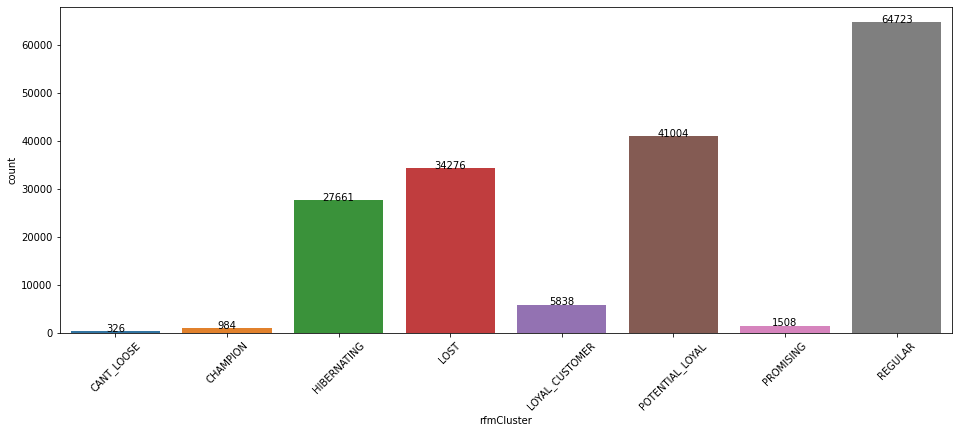

In [113]:

plt.figure(figsize=(16, 6))


chart = sns.countplot(x='rfmCluster', data=groupedByClient)
chart.set_xticklabels(chart.get_xticklabels(), rotation=45)

for p in chart.patches:
    height = p.get_height()
    chart.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

In [114]:
groupedByClient.groupby(['rfmCluster']).agg(FacturadoMedia=pd.NamedAgg(column="Facturado", aggfunc="mean"),
                                                    FacturadoXHabMedia = pd.NamedAgg(column="FacturadoXHab", aggfunc="mean"),
                                                    EdadMedia=pd.NamedAgg(column="Edad", aggfunc="mean"),
                                                    DiasReservaMedia = pd.NamedAgg(column="DiasReserva", aggfunc="mean"),
                                                    DiasEntreReservaEntradaMedia=pd.NamedAgg(column="DiasEntreReservaEntrada", aggfunc="mean"),
                                                    DiasDesdeUltimaReservaMedia = pd.NamedAgg(column="DiasDesdeUltimaReserva", aggfunc="mean"),
                                                    NumeroReservasMedia = pd.NamedAgg(column="NumeroReservas", aggfunc="mean"),
                                                    Cantidad = pd.NamedAgg(column="MesEntrada", aggfunc="count"),
                                                    )

,FacturadoMedia,FacturadoXHabMedia,EdadMedia,DiasReservaMedia,DiasEntreReservaEntradaMedia,DiasDesdeUltimaReservaMedia,NumeroReservasMedia,Cantidad
rfmCluster,,,,,,,,
CANT_LOOSE,3092.98,53.92,49.71,15.06,82.69,1084.01,2.29,326
CHAMPION,7723.50,32.75,47.82,34.78,79.55,377.49,4.54,984
HIBERNATING,1925.19,122.83,50.81,7.93,117.93,1086.69,1.00,27661
LOST,451.47,85.35,45.08,4.24,59.57,774.81,1.01,34276
LOYAL_CUSTOMER,4684.30,68.52,49.73,17.13,108.03,597.75,2.29,5838
POTENTIAL_LOYAL,2885.24,180.64,46.04,7.88,93.61,543.68,1.00,41004
PROMISING,644.17,40.56,46.24,6.57,35.77,596.28,2.36,1508
REGULAR,2052.55,137.98,45.47,7.33,97.49,820.75,1.01,64723


### Duracion de la estancia vs Anticipación

<Figure size 1152x432 with 0 Axes>

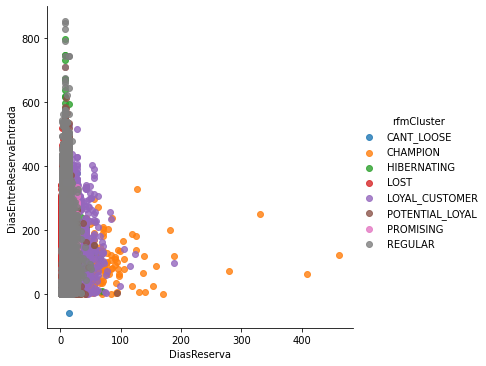

In [115]:
plt.figure(figsize=(16, 6))


sns.lmplot(x="DiasReserva", y = 'DiasEntreReservaEntrada', 
           data = groupedByClient, hue = 'rfmCluster', 
           fit_reg=False, legend=True, legend_out=True)

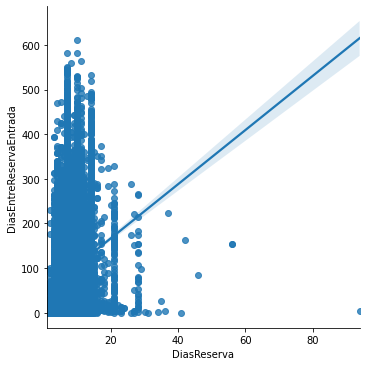

In [116]:
sns.lmplot(x="DiasReserva", y = 'DiasEntreReservaEntrada', 
           data = groupedByClient[groupedByClient["rfmCluster"] == "POTENTIAL_LOYAL"], 
           fit_reg=True, legend=True, legend_out=True)

### Estancias por edad

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


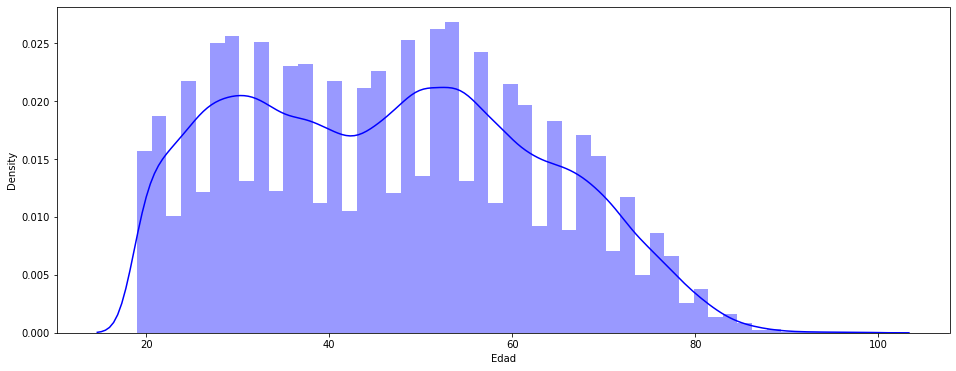

In [117]:

plt.figure(figsize=(16, 6)) 

sns.distplot(a=groupedByClient.Edad, color='blue')

Estancias por procedencia de clientes

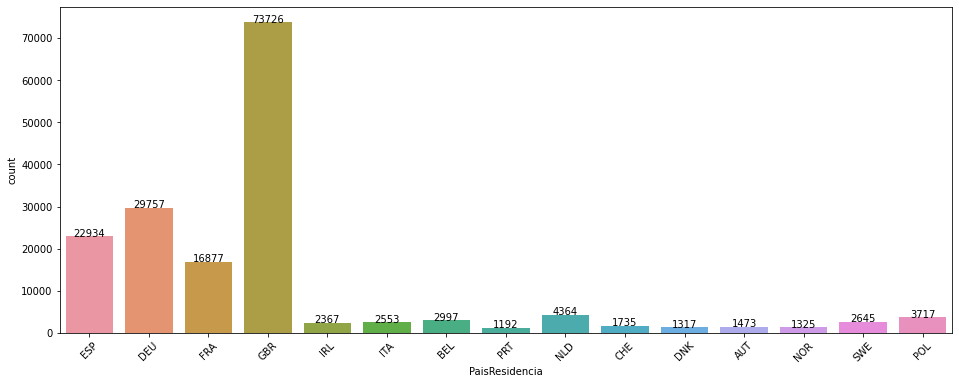

In [118]:
dfToGraph = groupedByClient["PaisResidencia"].value_counts().head(15)
# groupedByClient[groupedByClient["PaisResidencia"].isin(dfToGraph.index)]


plt.figure(figsize=(16, 6)) 

chart = sns.countplot(x='PaisResidencia', data=groupedByClient[groupedByClient["PaisResidencia"].isin(dfToGraph.index)])
chart.set_xticklabels(chart.get_xticklabels(), rotation=45)

for p in chart.patches:
    height = p.get_height()
    chart.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

/usr/local/lib/python3.7/dist-packages/plotnine/utils.py:1246: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if pdtypes.is_categorical(arr):


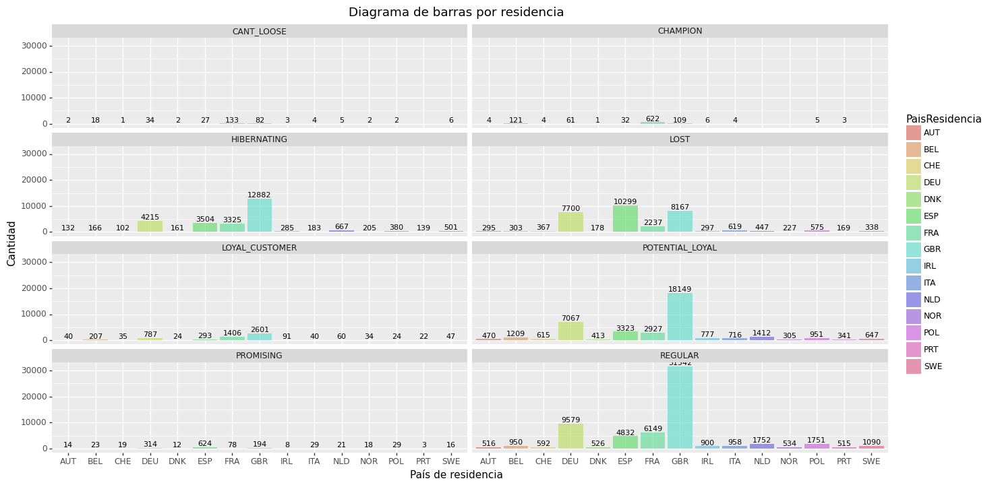

<ggplot: (8780129516753)>

In [119]:
# sns.factorplot(x='PaisResidencia',
#                hue='rfmCluster',
#                data=,
#                col='rfmCluster',
#                kind='swarm')



(ggplot(groupedByClient[groupedByClient["PaisResidencia"].isin(dfToGraph.index)], aes('PaisResidencia', fill='PaisResidencia'))         
 + aes(x='PaisResidencia')   
 + geom_bar(alpha = 0.6, show_legend=True) 
 + facet_wrap('~rfmCluster', ncol = 2)
 + geom_text(aes(label="stat(count)"), stat='count', nudge_y=0.125, va='bottom', size="8")
 + labs(
     x = 'País de residencia',
     y = 'Cantidad',
     title = 'Diagrama de barras por residencia'
 )
 + theme(figure_size=(16, 8))  # here you define the plot size
 

)

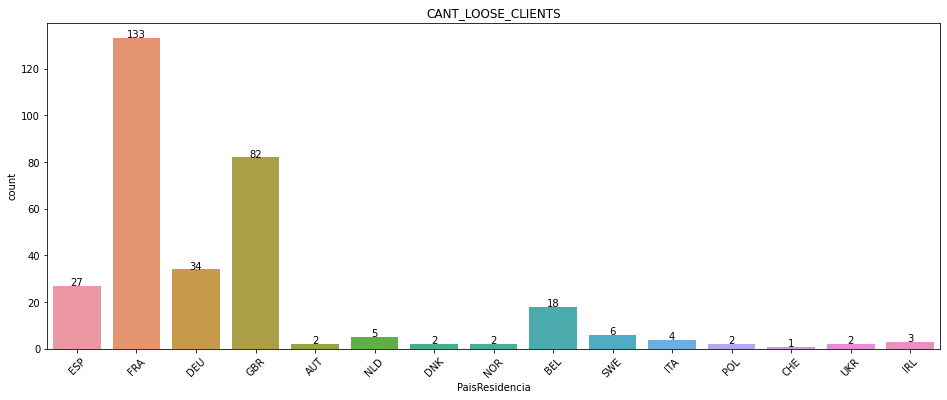

In [120]:

plt.figure(figsize=(16, 6)) 

chart = sns.countplot(x='PaisResidencia', data=groupedByClient[(groupedByClient["PaisResidencia"].isin(groupedByClient[groupedByClient["rfmCluster"] == "CANT_LOOSE"]["PaisResidencia"].value_counts().head(15).index)) & (groupedByClient["rfmCluster"] == "CANT_LOOSE")],)
chart.set_xticklabels(chart.get_xticklabels(), rotation=45)
chart.set_title("CANT_LOOSE_CLIENTS")

for p in chart.patches:
    height = p.get_height()
    chart.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

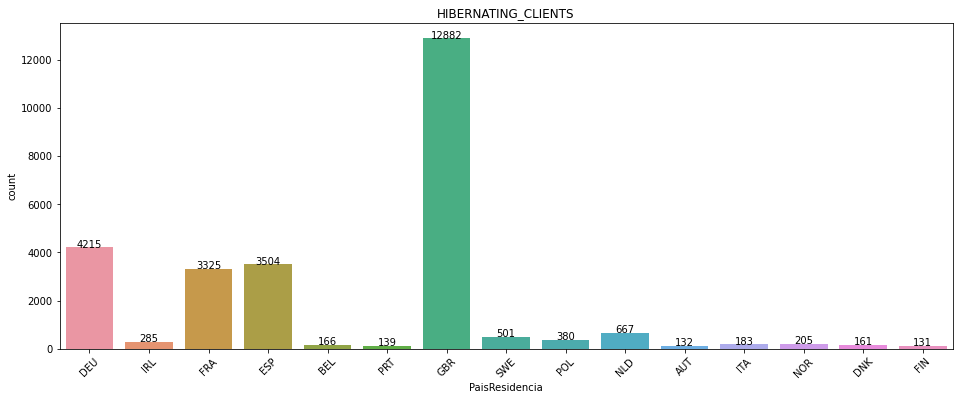

In [121]:



plt.figure(figsize=(16, 6)) 


chart = sns.countplot(x='PaisResidencia', data=groupedByClient[(groupedByClient["PaisResidencia"].isin(groupedByClient[groupedByClient["rfmCluster"] == "HIBERNATING"]["PaisResidencia"].value_counts().head(15).index)) & (groupedByClient["rfmCluster"] == "HIBERNATING")],)
chart.set_xticklabels(chart.get_xticklabels(), rotation=45)
chart.set_title("HIBERNATING_CLIENTS")

for p in chart.patches:
    height = p.get_height()
    chart.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

### Distribucion por hoteles

/usr/local/lib/python3.7/dist-packages/plotnine/utils.py:1246: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if pdtypes.is_categorical(arr):


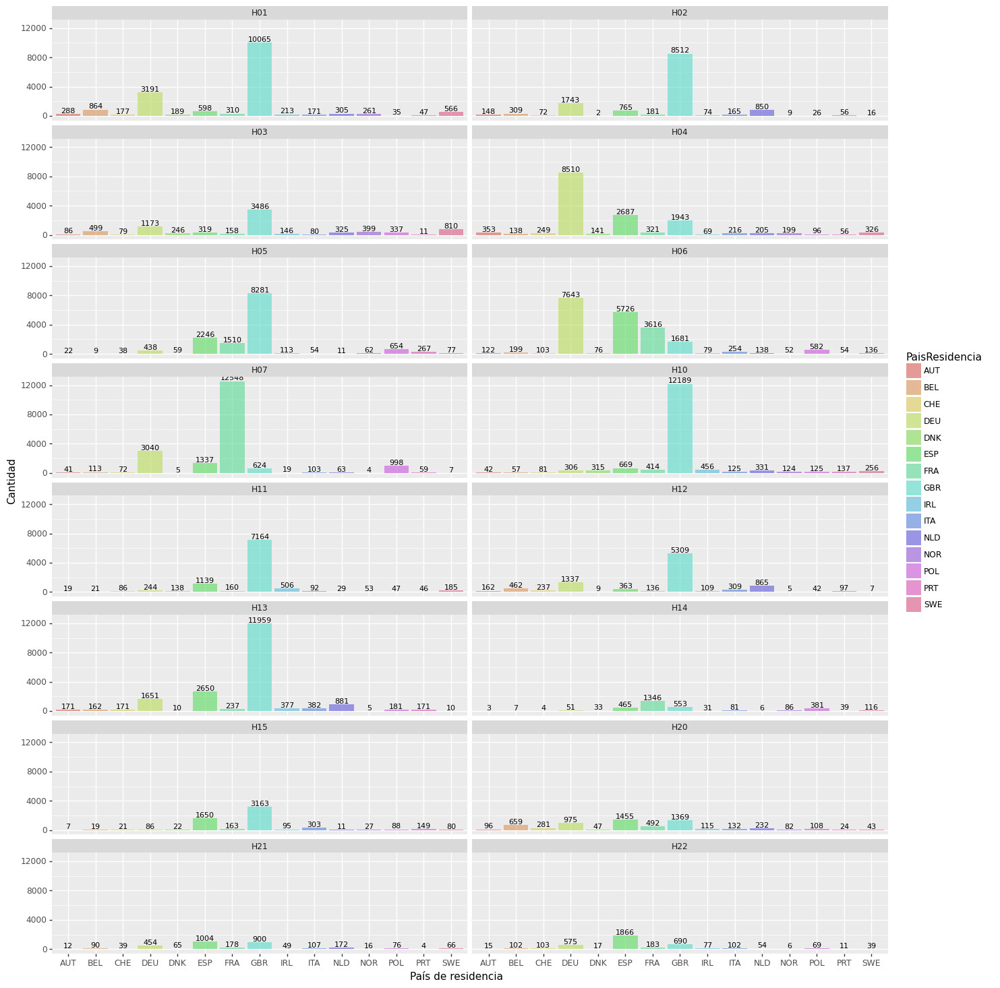

<ggplot: (8780130310773)>

In [122]:
(ggplot(groupedForRfmDf[groupedForRfmDf["PaisResidencia"].isin(dfToGraph.index)], aes('PaisResidencia', fill='PaisResidencia'))         
 + aes(x='PaisResidencia')   
 + geom_bar(alpha = 0.6, show_legend=True) 
 + facet_wrap('~HotelFactura', ncol = 2)
 + geom_text(aes(label="stat(count)"), stat='count', nudge_y=0.125, va='bottom', size="8")
 + labs(
     x = 'País de residencia',
     y = 'Cantidad',
 )
 + theme(figure_size=(16, 18))  # here you define the plot size
 

)

#### Agrupado por clientes

In [123]:
groupedByClient.groupby(['HotelFactura']).agg(FacturadoTotal=pd.NamedAgg(column="Facturado", aggfunc="sum"),
                                              FacturadoMedia=pd.NamedAgg(column="Facturado", aggfunc="mean"),
                                                    FacturadoXHabMedia = pd.NamedAgg(column="FacturadoXHab", aggfunc="mean"),
                                                    EdadMedia=pd.NamedAgg(column="Edad", aggfunc="mean"),
                                                    DiasReservaTotalMedia = pd.NamedAgg(column="DiasReserva", aggfunc="mean"),
                                                    DiasEntreReservaEntradaMedia=pd.NamedAgg(column="DiasEntreReservaEntrada", aggfunc="mean"),
                                                    NumeroReservasMedia = pd.NamedAgg(column="NumeroReservas", aggfunc="mean"),
                                                    Cantidad = pd.NamedAgg(column="MesEntrada", aggfunc="count"),
                                                    )

,FacturadoTotal,FacturadoMedia,FacturadoXHabMedia,EdadMedia,DiasReservaTotalMedia,DiasEntreReservaEntradaMedia,NumeroReservasMedia,Cantidad
HotelFactura,,,,,,,,
H01,37744426.31,2228.39,160.42,44.72,6.96,74.62,1.05,16938
H02,31646254.81,2547.60,169.05,44.62,7.50,90.59,1.07,12422
H03,16011011.54,1961.65,133.48,46.98,7.33,84.23,1.07,8162
H04,14067940.90,986.60,94.45,47.06,5.33,75.31,1.15,14259
H05,27839182.27,2067.21,120.95,46.81,8.00,118.45,1.09,13467
H06,21592566.90,1112.16,61.73,52.47,9.07,91.64,1.10,19415
H07,24026255.83,1497.24,87.00,46.64,8.49,69.75,1.15,16047
H10,43098373.95,2669.95,154.10,45.88,7.58,106.56,1.08,16142
H11,21915077.67,2255.33,138.16,45.44,7.00,116.98,1.05,9717


#### Agrupado por reservas

In [124]:
groupedForRfmDf.groupby(['HotelFactura']).agg(
                                                    AD=pd.NamedAgg(column="AD", aggfunc="mean"),
                                                    JR=pd.NamedAgg(column="JR", aggfunc="mean"),
                                                    NI=pd.NamedAgg(column="NI", aggfunc="mean"),
                                                    CU=pd.NamedAgg(column="CU", aggfunc="mean"),
                                                    Facturado=pd.NamedAgg(column="Facturado", aggfunc="sum"),
                                                    Edad=pd.NamedAgg(column="Edad", aggfunc="mean"),
                                                    DiasReservaMedia = pd.NamedAgg(column="DiasReserva", aggfunc="mean"),
                                                    DiasEntreReservaEntrada=pd.NamedAgg(column="DiasEntreReservaEntrada", aggfunc="mean"),
                                                    NumeroHabitaciones = pd.NamedAgg(column="NumeroHabitaciones", aggfunc="mean"),
                                                    FacturadoXHab = pd.NamedAgg(column="FacturadoXHab", aggfunc="mean"),
                                                    Cantidad = pd.NamedAgg(column="MesEntrada", aggfunc="count"),
                                                    )
# groupedForRfmDf

,AD,JR,NI,CU,Facturado,Edad,DiasReservaMedia,DiasEntreReservaEntrada,NumeroHabitaciones,FacturadoXHab,Cantidad
HotelFactura,,,,,,,,,,,
H01,3.87,0.00,0.00,0.00,38246745.43,44.80,6.63,74.55,1.95,163.54,17882
H02,3.87,0.00,0.00,0.00,31569059.59,45.00,7.05,91.39,1.96,173.19,13138
H03,3.78,0.00,0.00,0.00,15243121.94,47.05,6.85,84.31,1.92,136.88,8342
H04,3.04,0.00,0.00,0.00,13945906.96,47.43,4.61,72.96,1.67,97.57,16407
H05,4.27,0.01,0.80,0.17,27294543.71,46.81,7.32,117.91,2.01,124.66,14224
H06,3.51,0.02,0.15,0.03,21457667.06,52.27,8.20,88.64,1.82,64.27,21583
H07,3.77,0.15,0.11,0.05,24822746.24,46.78,7.43,72.60,1.89,91.03,19244
H10,4.54,0.00,0.62,0.15,42330255.94,46.12,7.00,107.40,2.09,160.31,17124
H11,4.92,0.00,1.37,0.18,22224410.28,45.42,6.64,116.46,2.15,141.05,10358


#### Numero de estancias

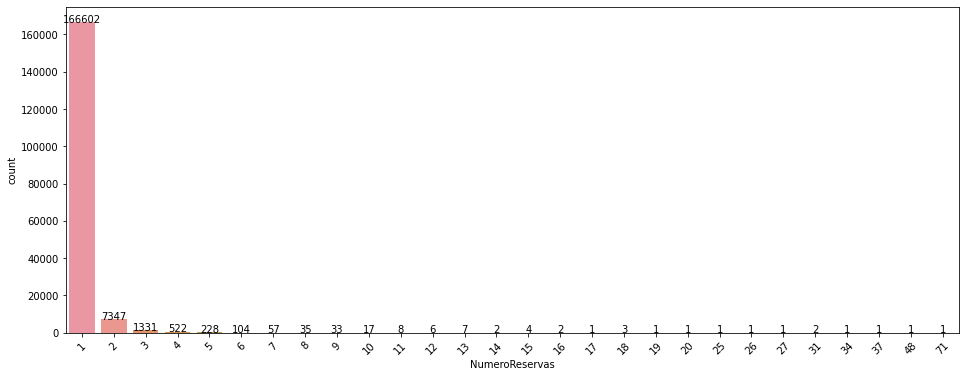

In [125]:
plt.figure(figsize=(16, 6)) 

chart = sns.countplot(x='NumeroReservas', data=groupedByClient)
chart.set_xticklabels(chart.get_xticklabels(), rotation=45)

for p in chart.patches:
    height = p.get_height()
    chart.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

### Client Life Cycle (estandar)

In [126]:
dfCycleLifeStd = groupedByClient.copy()

In [127]:
def getLifeCycleStage(row):
  if row["DiasDesdeUltimaReserva"] > 730:
    return "CHURNED"
  if row["DiasDesdeUltimaReserva"] > 365:
    return "DORMANT"
  if row["DiasDesdePrimeraReserva"] > 365:
    return "ACTIVE"
  return "NEW_CUSTOMER"


dfCycleLifeStd["LIFE_CYCLE"] = dfCycleLifeStd.apply(getLifeCycleStage, axis=1)

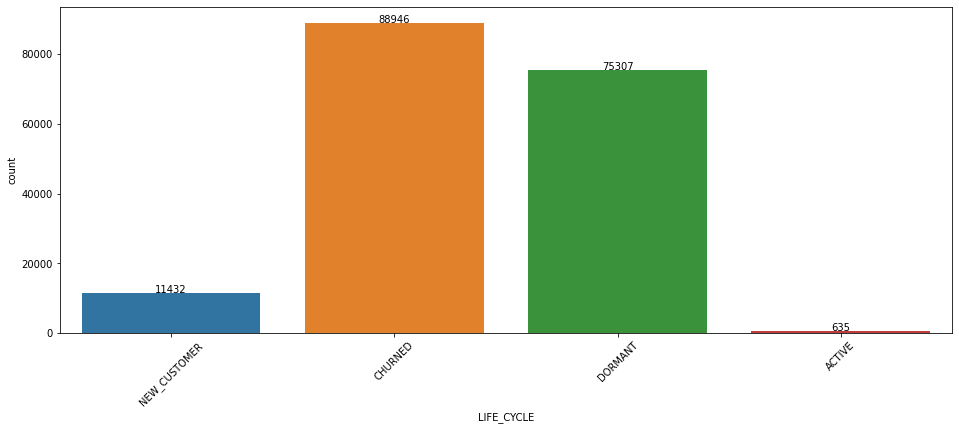

In [128]:
plt.figure(figsize=(16, 6)) 

chart = sns.countplot(x='LIFE_CYCLE', data=dfCycleLifeStd)
chart.set_xticklabels(chart.get_xticklabels(), rotation=45)

for p in chart.patches:
    height = p.get_height()
    chart.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

/usr/local/lib/python3.7/dist-packages/plotnine/utils.py:1246: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if pdtypes.is_categorical(arr):


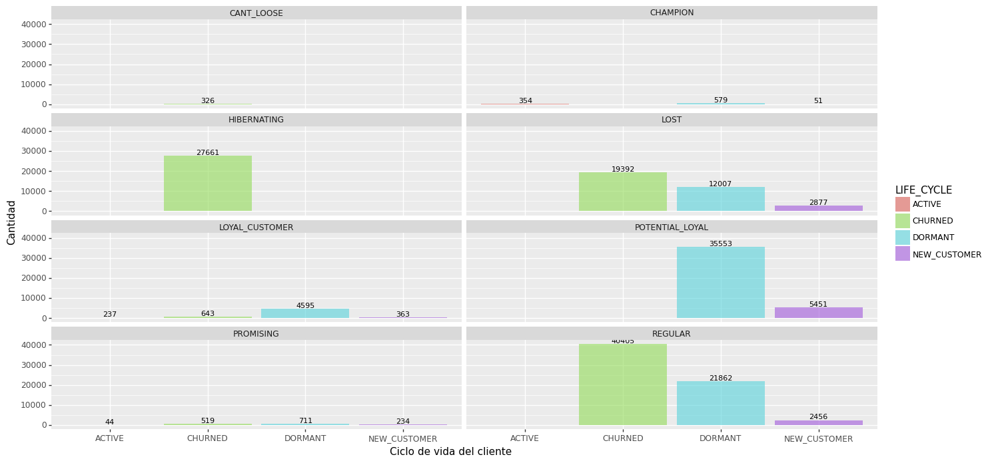

<ggplot: (8780132834753)>

In [129]:
(ggplot(dfCycleLifeStd, aes('LIFE_CYCLE', fill='LIFE_CYCLE'))         
 + aes(x='LIFE_CYCLE')   
 + geom_bar(alpha = 0.6, show_legend=True) 
 + facet_wrap('~rfmCluster', ncol = 2)
 + geom_text(aes(label="stat(count)"), stat='count', nudge_y=0.125, va='bottom', size="8")
 + labs(
     x = 'Ciclo de vida del cliente',
     y = 'Cantidad',
 )
 + theme(figure_size=(16, 8))  # here you define the plot size
 

)

/usr/local/lib/python3.7/dist-packages/plotnine/utils.py:1246: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if pdtypes.is_categorical(arr):


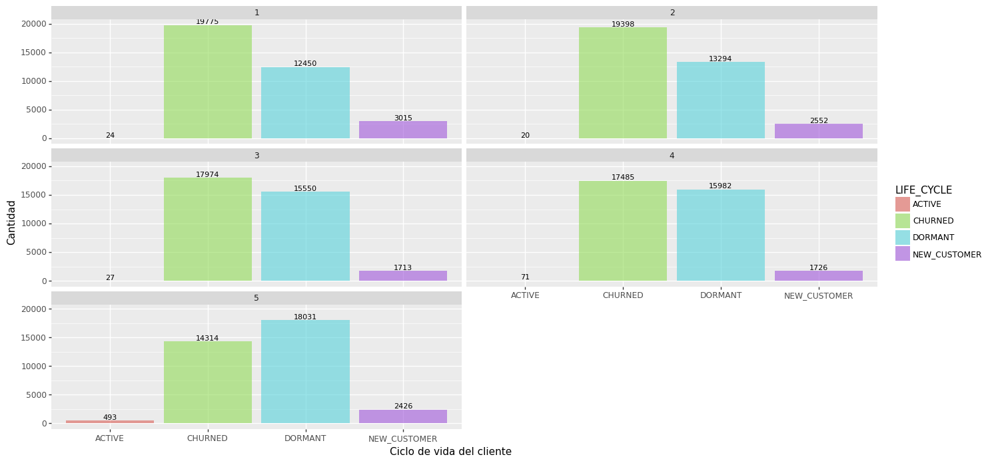

<ggplot: (8780129165917)>

In [130]:
(ggplot(dfCycleLifeStd, aes('LIFE_CYCLE', fill='LIFE_CYCLE'))         
 + aes(x='LIFE_CYCLE')   
 + geom_bar(alpha = 0.6, show_legend=True) 
 + facet_wrap('~Monetary', ncol = 2)
 + geom_text(aes(label="stat(count)"), stat='count', nudge_y=0.125, va='bottom', size="8")
 + labs(
     x = 'Ciclo de vida del cliente',
     y = 'Cantidad',
 )
 + theme(figure_size=(16, 8))  # here you define the plot size
 

)



AxesSubplot(0.125,0.749828;0.775x0.130172)
AxesSubplot(0.125,0.593621;0.775x0.130172)
AxesSubplot(0.125,0.437414;0.775x0.130172)
AxesSubplot(0.125,0.281207;0.775x0.130172)


posx and posy should be finite values
posx and posy should be finite values


AxesSubplot(0.125,0.125;0.775x0.130172)


posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


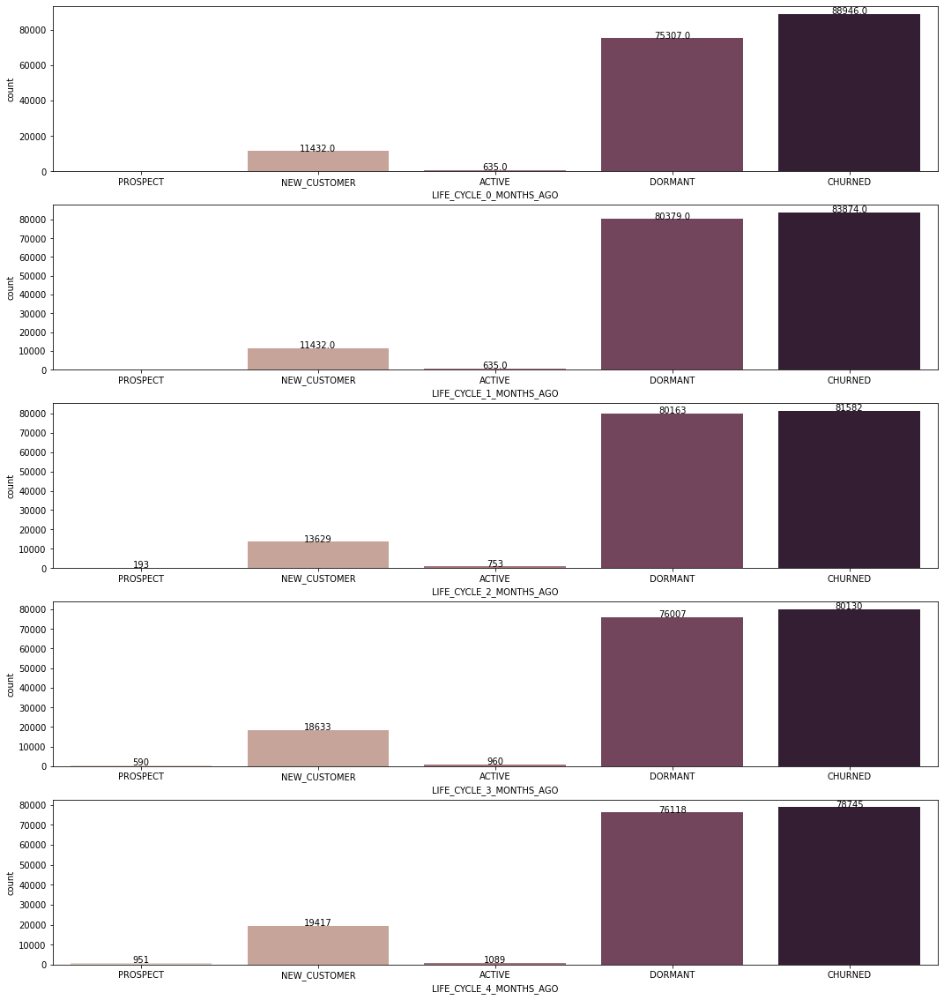

In [131]:
groupedByClientLifeCycles = dfCycleLifeStd.copy()

def getLifeCycleStage(row, daysBefore):

  daysSinceLastBooking = row["DiasDesdeUltimaReserva"] - daysBefore
  if daysSinceLastBooking <= 0:
    if row["DiasDesdePrimeraReserva"] - daysBefore<= 0:
      return "PROSPECT"
    daysSinceLastBooking = groupedForRfmDf[(groupedForRfmDf["Documento"] == row.name) & (groupedForRfmDf["DiasDesdeUltimaReserva"] > daysBefore)]["DiasDesdeUltimaReserva"].min()

  if daysSinceLastBooking > 730:
    return "CHURNED"
  if daysSinceLastBooking > 365:
    return "DORMANT"
  if row["DiasDesdePrimeraReserva"] - daysBefore> 365:
    return "ACTIVE"
  return "NEW_CUSTOMER"


def calculateLifeCycleForDate(df, columnName, daysBefore):
  df[columnName] = df.apply(getLifeCycleStage, args= (daysBefore,) , axis=1)


nMonths = 5
fig, axes = plt.subplots(nMonths, 1, figsize=(18, 20))

for item in range(0, nMonths):
  calculateLifeCycleForDate(groupedByClientLifeCycles, "LIFE_CYCLE_" + str(item) + "_MONTHS_AGO" , item*30 )
  chart = sns.countplot(ax=axes[item], x="LIFE_CYCLE_" + str(item) + "_MONTHS_AGO", palette="ch:.25", data=groupedByClientLifeCycles, order=['PROSPECT','NEW_CUSTOMER','ACTIVE', 'DORMANT', "CHURNED"])
  for p in chart.patches:
    height = p.get_height()
    chart.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")
  print(chart)

In [132]:
groupedByClientLifeCycles

,Sexo,PaisResidencia,AD,JR,NI,CU,HotelFactura,THFactura,RegimenFactura,Canal,Facturado,Edad,DiasReserva,DiasReservaMedia,DiasEntreReservaEntrada,MesEntrada,DiasDesdeUltimaReserva,DiasDesdePrimeraReserva,NumeroHabitaciones,FacturadoXHabMaxReserva,NumeroReservas,FacturadoXHab,Frequency,Regency,Monetary,MonetaryMean,rfmCluster,LIFE_CYCLE,LIFE_CYCLE_0_MONTHS_AGO,LIFE_CYCLE_1_MONTHS_AGO,LIFE_CYCLE_2_MONTHS_AGO,LIFE_CYCLE_3_MONTHS_AGO,LIFE_CYCLE_4_MONTHS_AGO
Documento,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
43804825Z,M,ESP,4,2,0,2,H20,DBL,HB,ONLINE,750.00,47.00,2,2.00,6.00,8,262,262,2.00,187.50,1,187.50,1,5,1,5,LOST,NEW_CUSTOMER,NEW_CUSTOMER,NEW_CUSTOMER,NEW_CUSTOMER,NEW_CUSTOMER,NEW_CUSTOMER
P71469453,M,DEU,1,0,0,0,H02,DBL,HB,DIRECT,1747.46,61.00,10,10.00,126.00,5,1087,1087,1.00,174.75,1,174.75,1,1,3,4,HIBERNATING,CHURNED,CHURNED,CHURNED,CHURNED,CHURNED,CHURNED
-1.145966,M,DEU,4,0,0,0,H04,DBL,BB,AGENCY,833.60,29.00,4,4.00,85.00,7,669,669,2.00,104.20,1,104.20,1,4,2,2,REGULAR,DORMANT,DORMANT,DORMANT,DORMANT,DORMANT,DORMANT
-4.2096E+11,M,FRA,4,0,0,0,H07,DBL,AI,TTOO,1600.00,36.00,7,7.00,81.00,12,495,495,2.00,114.29,1,114.29,1,5,3,3,POTENTIAL_LOYAL,DORMANT,DORMANT,DORMANT,DORMANT,DORMANT,DORMANT
.--411P17.-111:21111,M,GBR,4,0,0,0,H05,DBL,AI,TTOO,1975.40,32.00,7,7.00,82.00,7,666,666,2.00,141.10,1,141.10,1,4,4,4,POTENTIAL_LOYAL,DORMANT,DORMANT,DORMANT,DORMANT,DORMANT,DORMANT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
l2554652B,M,DEU,4,0,0,0,H01,DBL,AI,TTOO,2445.80,23.00,7,7.00,60.00,6,1046,1046,2.00,174.70,1,174.70,1,1,4,4,HIBERNATING,CHURNED,CHURNED,CHURNED,CHURNED,CHURNED,CHURNED
l369857254,F,DEU,4,0,0,0,H01,DBL,HB,TTOO,1795.92,23.00,6,6.00,193.00,8,629,629,2.00,149.66,1,149.66,1,4,3,4,POTENTIAL_LOYAL,DORMANT,DORMANT,DORMANT,DORMANT,DORMANT,DORMANT
l58685742,M,AUT,4,0,0,0,H01,DBL,AI,TTOO,2439.36,24.00,6,6.00,108.00,8,629,629,2.00,203.28,1,203.28,1,4,4,5,POTENTIAL_LOYAL,DORMANT,DORMANT,DORMANT,DORMANT,DORMANT,DORMANT


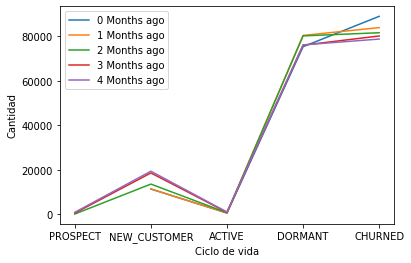

In [133]:

for i in range(0, nMonths):
  sns.lineplot(data=groupedByClientLifeCycles[f'LIFE_CYCLE_{i}_MONTHS_AGO'].value_counts().reindex(index = ['PROSPECT','NEW_CUSTOMER','ACTIVE', 'DORMANT', "CHURNED"]), label = str(i) + ' Months ago')
  

plt.xlabel('Ciclo de vida')
plt.ylabel('Cantidad')
plt.show()




# groupedByClientLifeCycles['LIFE_CYCLE_0_MONTHS_AGO'].value_counts().plot()

In [134]:
groupedByClientLifeCycles.groupby(['LIFE_CYCLE_1_MONTHS_AGO', "LIFE_CYCLE_0_MONTHS_AGO"]).agg(
                                                    Cantidad = pd.NamedAgg(column="MesEntrada", aggfunc="count")
                                                    )


Cantidad
LIFE_CYCLE_1_MONTHS_AGO LIFE_CYCLE_0_MONTHS_AGO          
ACTIVE                  ACTIVE                        635
CHURNED                 CHURNED                     83874
DORMANT                 CHURNED                      5072
                        DORMANT                     75307
NEW_CUSTOMER            NEW_CUSTOMER                11432

In [135]:
groupedByClientLifeCycles.groupby(['LIFE_CYCLE_4_MONTHS_AGO', "LIFE_CYCLE_0_MONTHS_AGO"]).agg(
                                                    Cantidad = pd.NamedAgg(column="MesEntrada", aggfunc="count")
                                                    )

Cantidad
LIFE_CYCLE_4_MONTHS_AGO LIFE_CYCLE_0_MONTHS_AGO          
ACTIVE                  ACTIVE                        527
                        DORMANT                       562
CHURNED                 ACTIVE                         15
                        CHURNED                     78730
DORMANT                 ACTIVE                         27
                        CHURNED                     10216
                        DORMANT                     65875
NEW_CUSTOMER            ACTIVE                         66
                        DORMANT                      8870
                        NEW_CUSTOMER                10481
PROSPECT                NEW_CUSTOMER                  951

### Client Life Cycle (aumentado por covid)

In [136]:
dfCycleLifeCovid = groupedByClient.copy()

AxesSubplot(0.125,0.749828;0.775x0.130172)
AxesSubplot(0.125,0.593621;0.775x0.130172)
AxesSubplot(0.125,0.437414;0.775x0.130172)
AxesSubplot(0.125,0.281207;0.775x0.130172)


posx and posy should be finite values
posx and posy should be finite values


AxesSubplot(0.125,0.125;0.775x0.130172)


posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


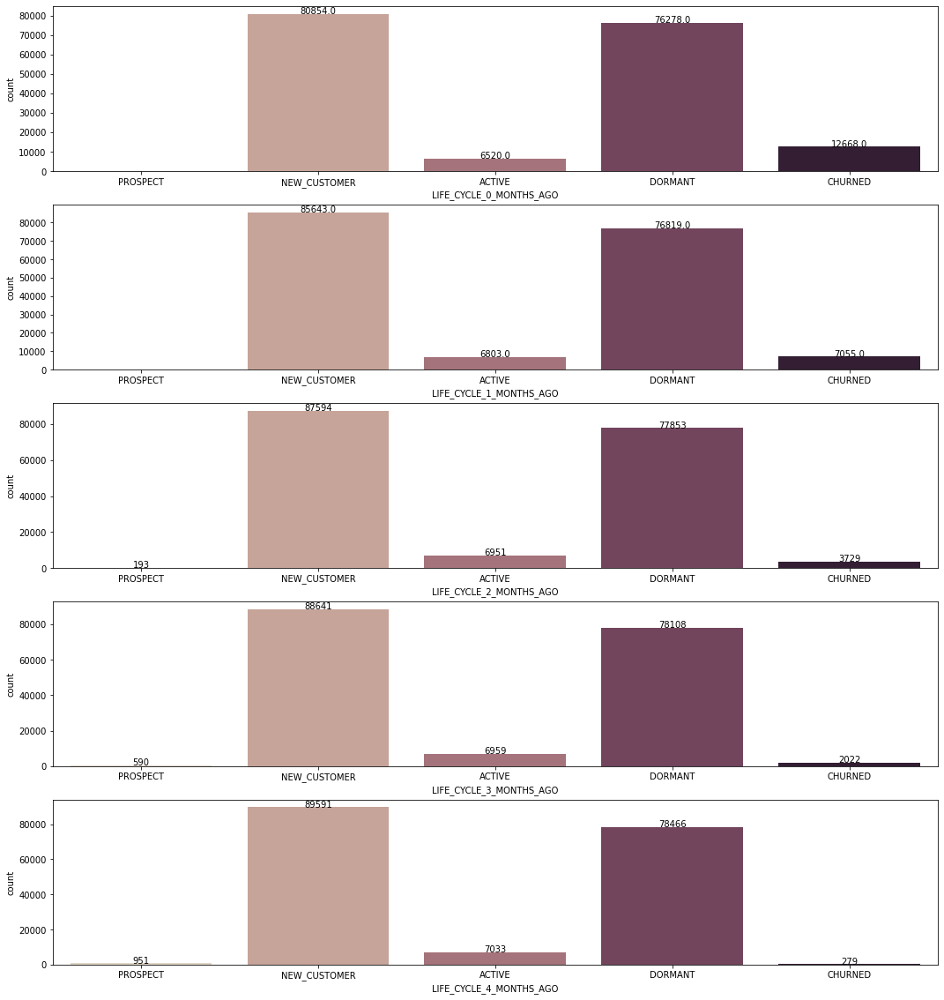

In [137]:
def getLifeCycleStageCovid(row, daysBefore):

  daysSinceLastBooking = row["DiasDesdeUltimaReserva"] - daysBefore
  if daysSinceLastBooking <= 0:
    if row["DiasDesdePrimeraReserva"] - daysBefore<= 0:
      return "PROSPECT"
    daysSinceLastBooking = groupedForRfmDf[(groupedForRfmDf["Documento"] == row.name) & (groupedForRfmDf["DiasDesdeUltimaReserva"] > daysBefore)]["DiasDesdeUltimaReserva"].min()

  if daysSinceLastBooking > 1095:
    return "CHURNED"
  if daysSinceLastBooking > 730:
    return "DORMANT"
  if row["DiasDesdePrimeraReserva"] - daysBefore> 365 and row['NumeroReservas']> 1:
    return "ACTIVE"
  return "NEW_CUSTOMER"


def calculateLifeCycleForDate(df, columnName, daysBefore):
  df[columnName] = df.apply(getLifeCycleStageCovid, args= (daysBefore,) , axis=1)


nMonths = 5
fig, axes = plt.subplots(nMonths, 1, figsize=(18, 20))

for item in range(0, nMonths):
  calculateLifeCycleForDate(dfCycleLifeCovid, "LIFE_CYCLE_" + str(item) + "_MONTHS_AGO" , item*30 )
  chart = sns.countplot(ax=axes[item], x="LIFE_CYCLE_" + str(item) + "_MONTHS_AGO", palette="ch:.25", data=dfCycleLifeCovid, order=['PROSPECT','NEW_CUSTOMER','ACTIVE', 'DORMANT', "CHURNED"])
  for p in chart.patches:
    height = p.get_height()
    chart.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")
  print(chart)

In [138]:
dfCycleLifeCovid.groupby(['LIFE_CYCLE_1_MONTHS_AGO', "LIFE_CYCLE_0_MONTHS_AGO"]).agg(
                                                    Cantidad = pd.NamedAgg(column="MesEntrada", aggfunc="count")
                                                    )

Cantidad
LIFE_CYCLE_1_MONTHS_AGO LIFE_CYCLE_0_MONTHS_AGO          
ACTIVE                  ACTIVE                       6520
                        DORMANT                       283
CHURNED                 CHURNED                      7055
DORMANT                 CHURNED                      5613
                        DORMANT                     71206
NEW_CUSTOMER            DORMANT                      4789
                        NEW_CUSTOMER                80854

In [139]:
dfCycleLifeCovid.groupby(['LIFE_CYCLE_4_MONTHS_AGO', "LIFE_CYCLE_0_MONTHS_AGO"]).agg(
                                                    Cantidad = pd.NamedAgg(column="MesEntrada", aggfunc="count")
                                                    )

Cantidad
LIFE_CYCLE_4_MONTHS_AGO LIFE_CYCLE_0_MONTHS_AGO          
ACTIVE                  ACTIVE                       6258
                        DORMANT                       775
CHURNED                 CHURNED                       279
DORMANT                 ACTIVE                         15
                        CHURNED                     12389
                        DORMANT                     66062
NEW_CUSTOMER            ACTIVE                        247
                        DORMANT                      9441
                        NEW_CUSTOMER                79903
PROSPECT                NEW_CUSTOMER                  951

#### Clasificacion de acuerdo a lo gastado

/usr/local/lib/python3.7/dist-packages/plotnine/utils.py:1246: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if pdtypes.is_categorical(arr):


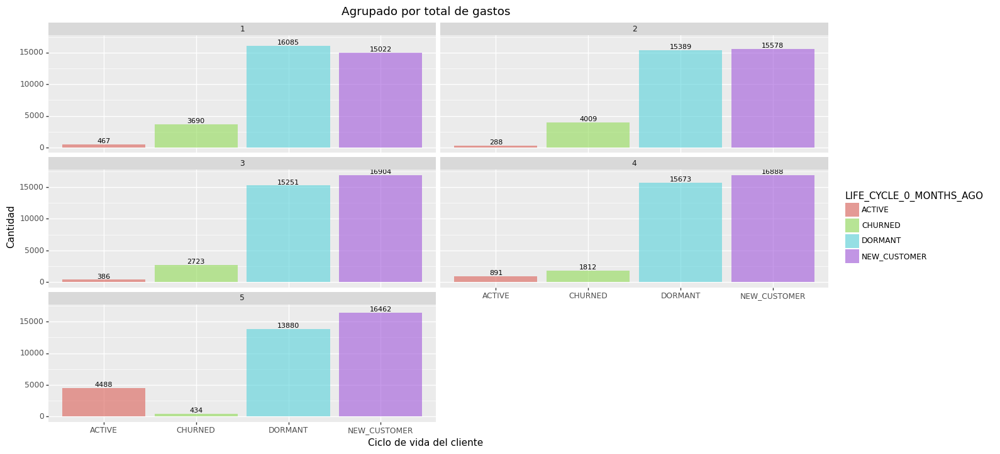

<ggplot: (8780132750625)>

In [140]:
(ggplot(dfCycleLifeCovid, aes('LIFE_CYCLE_0_MONTHS_AGO', fill='LIFE_CYCLE_0_MONTHS_AGO'))         
 + aes(x='LIFE_CYCLE_0_MONTHS_AGO')   
 + geom_bar(alpha = 0.6, show_legend=True) 
 + facet_wrap('~Monetary', ncol = 2)
 + geom_text(aes(label="stat(count)"), stat='count', nudge_y=0.125, va='bottom', size="8")
 + labs(
     title = "Agrupado por total de gastos",
     x = 'Ciclo de vida del cliente',
     y = 'Cantidad',
 )
 + theme(figure_size=(16, 8))  # here you define the plot size
 

)


/usr/local/lib/python3.7/dist-packages/plotnine/utils.py:1246: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if pdtypes.is_categorical(arr):


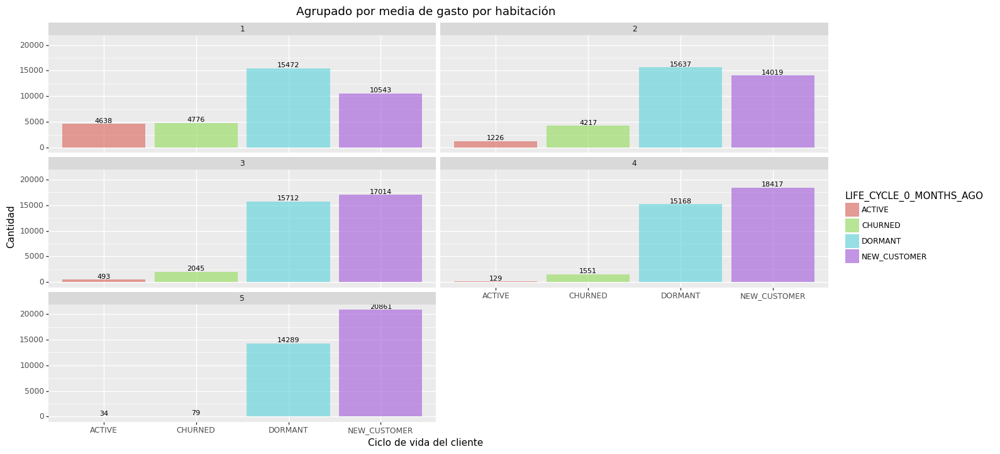

<ggplot: (8780129790897)>

In [141]:
(ggplot(dfCycleLifeCovid, aes('LIFE_CYCLE_0_MONTHS_AGO', fill='LIFE_CYCLE_0_MONTHS_AGO'))         
 + aes(x='LIFE_CYCLE_0_MONTHS_AGO')   
 + geom_bar(alpha = 0.6, show_legend=True) 
 + facet_wrap('~MonetaryMean', ncol = 2)
 + geom_text(aes(label="stat(count)"), stat='count', nudge_y=0.125, va='bottom', size="8")
 + labs(
     title = "Agrupado por media de gasto por habitación",
     x = 'Ciclo de vida del cliente',
     y = 'Cantidad',
 )
 + theme(figure_size=(16, 8))  # here you define the plot size
 

)

# dfCycleLifeCovid.columns


### Canal de venta

/usr/local/lib/python3.7/dist-packages/plotnine/utils.py:1246: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if pdtypes.is_categorical(arr):


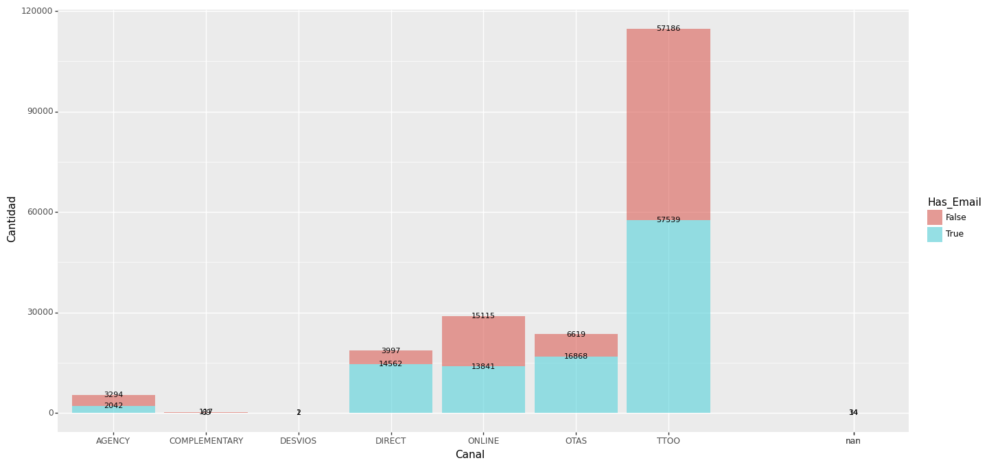

<ggplot: (8780129218665)>

In [142]:
(ggplot(groupedForRfmDf, aes(fill='Has_Email'))    
 + aes(x='Canal')   

+ geom_bar(alpha = 0.6, show_legend=True)
 + geom_text(aes(label="stat(count)"), stat='count', va='center', size="8", position='stack')
 + labs(
     x = 'Canal',
     y = 'Cantidad',
 )
 + theme(figure_size=(16, 8))  # here you define the plot size
)


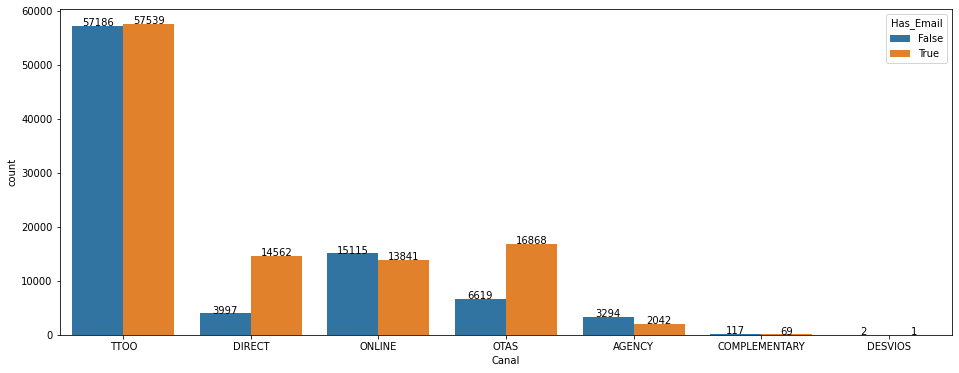

In [143]:
plt.figure(figsize=(16, 6)) 


chart = sns.countplot(x='Canal', hue="Has_Email", data=groupedForRfmDf)
for p in chart.patches:
    height = p.get_height()
    chart.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

In [144]:
%load_ext google.colab.data_table

In [148]:
data_table.DataTable(groupedForRfmDf, include_index=True, num_rows_per_page=20, max_columns=25)

,,Sexo,PaisResidencia,Documento,Entrada,Salida,AD,JR,NI,CU,HotelFactura,THFactura,RegimenFactura,Canal,Has_Email,Facturado,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,NumeroHabitaciones,FacturadoXHab,DiasDesdeUltimaReserva,Year
Reserva,Linea,,,,,,,,,,,,,,,,,,,,,,,
2020/00016,1,M,DEU,L6WLFNM8L,2/1/2020,2/7/2020,4,0,0,0,H22,DBL,BB,TTOO,False,2105.78,56.00,6,352.00,2,2,175.48,454,2020
2020/00020,1,F,GBR,519702893,2/1/2020,2/4/2020,4,0,0,0,H21,JSTSUP,AI,TTOO,False,960.00,68.00,3,362.00,2,2,160.00,454,2020
2020/00035,1,M,DEU,C9038Z0PN,2/4/2020,2/13/2020,4,0,0,0,H22,DBVM,BB,DIRECT,False,7773.54,78.00,9,315.00,2,2,431.86,451,2020
2020/00049,1,F,NOR,31277024,2/1/2020,2/2/2020,4,0,0,0,H21,JSTSUP,AI,TTOO,False,309.68,64.00,1,329.00,2,2,154.84,454,2020
2020/00062,1,F,GBR,538118225,2/7/2020,2/14/2020,4,0,0,0,H21,JSTSUP,AI,ONLINE,False,2352.00,49.00,7,322.00,2,2,168.00,448,2020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TNRE190021957,2,M,FRA,1.20362E+11,6/30/2019,7/7/2019,4,0,0,0,H05,DBL,AI,TTOO,False,1873.20,22.00,7,118.00,6,2,133.80,670,2019
TNRE190021959,1,M,FRA,12030230 688,9/22/2019,9/29/2019,4,0,0,0,H05,DBL,AI,TTOO,False,1695.12,50.00,7,202.00,9,2,121.08,586,2019
TNRE190021960,1,M,FRA,1.4126E+11,7/6/2019,7/20/2019,4,0,2,0,H05,DBL,AI,TTOO,False,3706.80,37.00,14,124.00,7,2,132.39,664,2019


In [146]:
data_table.DataTable(dfCardexCleaned2, include_index=True, num_rows_per_page=20, max_columns=35)

,Documento,Sexo,FechaNacimiento,PaisResidencia,EMail,Reserva,Linea,Numero,HotelUso,Estado,Entrada,Salida,THUso,RegimenUso,AD,JR,NI,CU,EntidadNegocio,HotelFactura,THFactura,RegimenFactura,Venta,Canal,Facturado,Has_Email,Edad,DiasReserva,DiasEntreReservaEntrada,MesEntrada,FacturadoXDia
3,03908922A,M,2/10/1984,ESP,NaN,TGHRE170006338,1,1,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,288.04,False,33.00,5,56.00,5,57.61
4,47077585N,F,4/28/1984,ESP,NaN,TGHRE170006338,1,2,H06,Salida,5/1/2017,5/6/2017,DBL,HB,2,0,1,0,V.SOLTOUR SA,H06,DBL,HB,3/6/2017,TTOO,288.04,False,33.00,5,56.00,5,57.61
78,1537926865,M,9/14/1929,DEU,NaN,LZRE170032022,1,1,H04,Salida,11/15/2017,2/22/2018,DBVM,HB,1,0,0,0,SCHAUINSLAND,H04,DUI,HB,8/2/2017,NaN,5308.00,False,88.00,99,105.00,11,53.62
105,265327238,F,6/7/1969,DEU,FRENNA@EIRE.DE,LZRE170033051,1,1,H04,Salida,11/25/2017,11/30/2017,DBL,BB,2,0,0,0,SIDETOURS/ALEMAN,H04,DBL,BB,9/26/2017,NaN,662.19,True,48.00,5,60.00,11,132.44
106,L3R10H581,F,9/25/1995,DEU,FRENNA@EIRE.DE,LZRE170033051,1,2,H04,Salida,11/25/2017,11/30/2017,DBL,BB,2,0,0,0,SIDETOURS/ALEMAN,H04,DBL,BB,9/26/2017,NaN,662.19,True,22.00,5,60.00,11,132.44
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
386039,L1T1PRV55W,M,5/24/1971,DEU,NaN,H20RE210010231,1,2,H20,En Hotel,3/17/2021,3/20/2021,DBVMPC,BB,2,0,0,0,DIRECTO,H20,DBL,BB,3/15/2021,DIRECT,375.00,False,50.00,3,2.00,3,125.00
386040,JCL3X9E5,M,11/27/1990,LUX,NaN,H20RE210010325,1,2,H20,En Hotel,3/17/2021,3/24/2021,JSVMPC,HB,2,0,0,0,DIRECTO WEB AMIGO,H20,JSVMPC,HB,3/17/2021,DIRECT,2052.97,False,31.00,7,0.00,3,293.28
386041,C4YMXL71G,F,1/24/1991,GBR,dianakyllmann@gmail.com,H20RE210010317,1,2,H20,En Hotel,3/17/2021,3/18/2021,DBVMPC,BB,2,0,0,0,DIRECTO,H20,DBVMPC,BB,3/17/2021,DIRECT,215.66,True,30.00,1,0.00,3,215.66
386042,19E177251,M,6/29/1963,FRA,adsuarfamily@hotmail.fr,H20RE210010002,2,1,H20,En Hotel,3/17/2021,3/22/2021,DBVM,BB,2,0,0,0,BOOKING.COM B.V.,H20,DBVM,BB,3/10/2021,OTAS,1191.00,True,58.00,5,7.00,3,238.20


In [ ]:
%unload_ext google.colab.data_table